In [1]:
import numpy as np
from scipy import linalg
from scipy.spatial.transform import Rotation as R
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import matplotlib.collections
import matplotlib.patches
import pg_fitter_tools as fit
import sk_geo_tools as geo
import cv2
from collections import Counter

In [2]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [3]:
#%matplotlib notebook
%load_ext autoreload
%autoreload 2

In [4]:
def get_feature_positions(feature_count, mpmt_locations):
    feature_ring_radius = 24.
    feature_positions = {}
    for k, v in mpmt_locations.items():
        for i in range(feature_count):
            if abs(v[2]) > 2740:
                feature_positions[k+'-'+str(i)] = v+feature_ring_radius*np.array([np.sin(i*2*np.pi/feature_count),np.cos(i*2*np.pi/feature_count),0])
            else:
                phi = np.arctan2(v[1], v[0])
                feature_positions[k+'-'+str(i)] = v+feature_ring_radius*np.array([np.sin(i*2*np.pi/feature_count)*np.sin(phi), -np.sin(i*2*np.pi/feature_count)*np.cos(phi), np.cos(i*2*np.pi/feature_count)])
    return feature_positions

In [5]:
def get_image_feature_locations(feature_positions, camera_matrix, distortion, camera_rotations, camera_translations, image_size):
    image_feature_locations = {
        i : {list(feature_positions.keys())[f]:v for f, v in enumerate(cv2.projectPoints(np.array(list(feature_positions.values())), r, t, camera_matrix, distortion)[0].reshape((-1,2)))
             if v[0] > 0 and v[0] < image_size[0] and v[1] > 0 and v[1] < image_size[1]}
        for i, (r, t) in enumerate(zip(camera_rotations, camera_translations))}
    feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
    print("Feature in image counts:", Counter(feature_counts.values()))
    return image_feature_locations

In [6]:
def get_smeared_feature_locations(image_feature_locations, pixel_error, image_size):
    smeared_feature_locations = {}
    for k, i in image_feature_locations.items():
        smeared_feature_locations[k] = {}
        for j, f in i.items():
            smeared = np.random.normal(f, pixel_error)
            if(smeared[0] > 0 and smeared[0] < image_size[0] and smeared[1] > 0 and smeared[1] < image_size[1]):
                smeared_feature_locations[k][j] = smeared
    smeared_feature_counts = Counter([f for i in smeared_feature_locations.values() for f in i.keys()])
    print("Smeared feature in image counts:", Counter(smeared_feature_counts.values()))
    return smeared_feature_locations

In [7]:
def setup_feature_simulation(feature_positions, image_feature_locations, focal_length, principle_point, radial_distortion, seed_error=1):
    seed_feature_positions = {}
    for i, f in feature_positions.items():
        seed_feature_positions[i] = np.random.normal(f, seed_error)
    fitter = fit.PhotogrammetryFitter(image_feature_locations, seed_feature_positions, focal_length, principle_point, radial_distortion)
    return fitter

In [8]:
def plot_images(image_feature_locations, image_size):
    for i in image_feature_locations.values():
        fig, ax = plt.subplots(figsize=(12,9))
        coords = np.rint(np.stack(list(i.values())))
        ax.scatter(coords[:,0], -coords[:,1], marker='s', s=0.2)
        ax.set_xlim((0, image_size[0]))
        ax.set_ylim((-image_size[1], 0))
        ax.axes.xaxis.set_visible(False)
        ax.axes.yaxis.set_visible(False)
        fig.tight_layout()

In [9]:
def run_feature_fit(fitter, feature_positions):
    reco_cam_rotations, reco_cam_translations, reprojected_points = fitter.estimate_camera_poses()
    reco_cam_rotations, reco_cam_translations, reco_locations = fitter.bundle_adjustment(reco_cam_rotations, reco_cam_translations)
    
    reco_errors, reco_transformed, scale, R, translation, _ = fit.kabsch_errors(feature_positions, reco_locations)
    print("mean reconstruction error:", linalg.norm(reco_errors, axis=1).mean())
    print("max reconstruction error:", linalg.norm(reco_errors, axis=1).max())

    reco_cam_orientations, reco_cam_positions = fit.camera_world_poses(reco_cam_rotations, reco_cam_translations)
    cam_orientations_transformed = np.matmul(R, reco_cam_orientations)
    cam_positions_translated = reco_cam_positions - translation
    cam_positions_transformed = scale*R.dot(cam_positions_translated.transpose()).transpose()

    reco_feature_positions = reco_positions_dict(reco_transformed, fitter.feature_index)
    position_errors = linalg.norm(reco_errors, axis=1)

    return reco_feature_positions, position_errors

In [10]:
def reco_positions_dict(reco_positions, feature_index):
    return {f: reco_positions[i] for f, i in feature_index.items()}

In [11]:
def get_mpmt_centre_errors(reco_feature_positions, mpmt_positions, feature_count):
    reco_mpmt_positions = {k: np.mean([reco_feature_positions[k + "-" + str(b)] for b in range(feature_count)], axis=0)
                           for k in mpmt_positions.keys()}
    errors = np.array([linalg.norm(reco_mpmt_positions[k] - mpmt_positions[k]) for k in mpmt_positions.keys()])
    return errors

In [12]:
def get_mpmt_orientation_errors(reco_feature_positions, mpmt_orientations, feature_coun):
    reco_orientations = {}
    for k in mpmt_orientations.keys():
        c, n = geo.fit_plane(np.array([reco_feature_positions[k + "-" + str(b)] for b in range(feature_count)]))
        # flip normal if it is directed away from tank centre
        if np.dot(n,c) > 0:
            n = -n
        reco_orientations[k] = n
    errors = np.array([np.degrees(np.arccos(np.dot(reco_orientations[k], mpmt_orientations[k]))) for k in mpmt_orientations.keys()])
    return errors

In [13]:
def make_fig(title=None, xlabel=None, ylabel=None, figsize=(8,6)):
    fig, ax = plt.subplots(figsize=figsize)
    ax.set_title(title)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    fig.tight_layout()
    return fig, ax

In [14]:
def plot_geometry(feature_positions, cam_positions):
    fig = plt.figure(figsize=(36,27))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter([l[0] for l in feature_positions.values()], [l[1] for l in feature_positions.values()], [l[2] for l in feature_positions.values()], marker='*', label="feature", s=1)
    ax.scatter(cam_positions[:,0], cam_positions[:,1], cam_positions[:,2], marker='o', label="Camera", s=60)
    plt.legend(loc=0)
    fig.tight_layout()

In [15]:
def plot_reconstruction(reco_positions, cam_positions):
    fig = plt.figure(figsize=(12,9))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(reco_positions[:,0], reco_positions[:,1], reco_positions[:,2], marker='*', label="feature", s=1)
    ax.scatter(cam_positions[:,0], cam_positions[:,1], cam_positions[:,2], marker='o', label="Camera", s=60)
    plt.legend(loc=0)
    fig.tight_layout()

In [16]:
pixel_errors = [1.0, 3.0, 5.0, 10.0]

In [17]:
pmt_locations = fit.read_3d_feature_locations("parameters/HyperK_allPMTs.txt", delimiter="\t")
#mpmt_locations = {k: v for k, v in pmt_locations.items() if int(k)%19==0}
#mpmt_locations = fit.read_3d_feature_locations("parameters/HK_centrePMT_locations.txt", delimiter=" ")
mpmt_locations = {k: np.array((v[0], v[1], v[2])) for k, v in pmt_locations.items()}
mpmt_orientations = {k:   np.array((0,    0,   -1)) if v[2] > 2740           # top endcap
                     else np.array((0,    0,    1)) if v[2] < -2740          # bottom endcap
                     else np.array((-v[0],-v[1],0))/np.sqrt(v[0]**2+v[1]**2) # barrel
                     for k, v in mpmt_locations.items()}
feature_count = 12
feature_positions = get_feature_positions(feature_count, mpmt_locations)

# Simulation with Sony A6000

In [18]:
focal_length = np.array([2925.84685880484, 2930.0351899542])
principle_point = np.array([3000, 2000])
radial_distortion = np.array([-0.251288719187471, 0.0622370807856553])#[-0.28009, 0.11246, -0.02736])
tangential_distortion = np.array([0, 0])
camera_matrix = fit.build_camera_matrix(focal_length, principle_point)
distortion = fit.build_distortion_array(radial_distortion, tangential_distortion)
image_size = np.array([6000, 4000])
image_area = [[0,image_size[0]],[0,image_size[1]]]

## 6 camera configuration A

In [19]:
camera_radial_position = 3549.1*0.75
camera_halfz_position = 2748.9
camera_positions = np.array([
    [    -camera_radial_position,  0                                  , -camera_halfz_position],
    [ 0.5*camera_radial_position, -camera_radial_position*np.sqrt(3)/2, -camera_halfz_position],
    [ 0.5*camera_radial_position,  camera_radial_position*np.sqrt(3)/2, -camera_halfz_position],
    [     camera_radial_position,  0                                  ,  camera_halfz_position],
    [-0.5*camera_radial_position, -camera_radial_position*np.sqrt(3)/2,  camera_halfz_position],
    [-0.5*camera_radial_position,  camera_radial_position*np.sqrt(3)/2,  camera_halfz_position]])
camera_tilt = 0.92
camera_zenith = np.sqrt(1-camera_tilt**2)
camera_directions = [[   1*camera_zenith,             0*camera_zenith,  camera_tilt],
                     [-0.5*camera_zenith,  np.sqrt(3)/2*camera_zenith,  camera_tilt],
                     [-0.5*camera_zenith, -np.sqrt(3)/2*camera_zenith,  camera_tilt],
                     [  -1*camera_zenith,             0*camera_zenith, -camera_tilt],
                     [ 0.5*camera_zenith,  np.sqrt(3)/2*camera_zenith, -camera_tilt],
                     [ 0.5*camera_zenith, -np.sqrt(3)/2*camera_zenith, -camera_tilt]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, 0.0, 0.0, 0.0, 0.0, 0.0])#[np.pi/2, np.pi/2, np.pi/2, np.pi/2])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [20]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({3: 369720, 4: 48756, 5: 42900})


In [21]:
{k: v/sum(feature_counts_counts.values()) for k,v in feature_counts_counts.items()}

{4: 0.1056751976695797, 5: 0.09298272992093216, 3: 0.8013420724094882}

In [22]:
sum(k*v for k,v in feature_counts_counts.items())/len(feature_positions)

3.291640657511444

In [23]:
bad_features = {f:v for f, v in feature_positions.items() if feature_counts[f]<3}

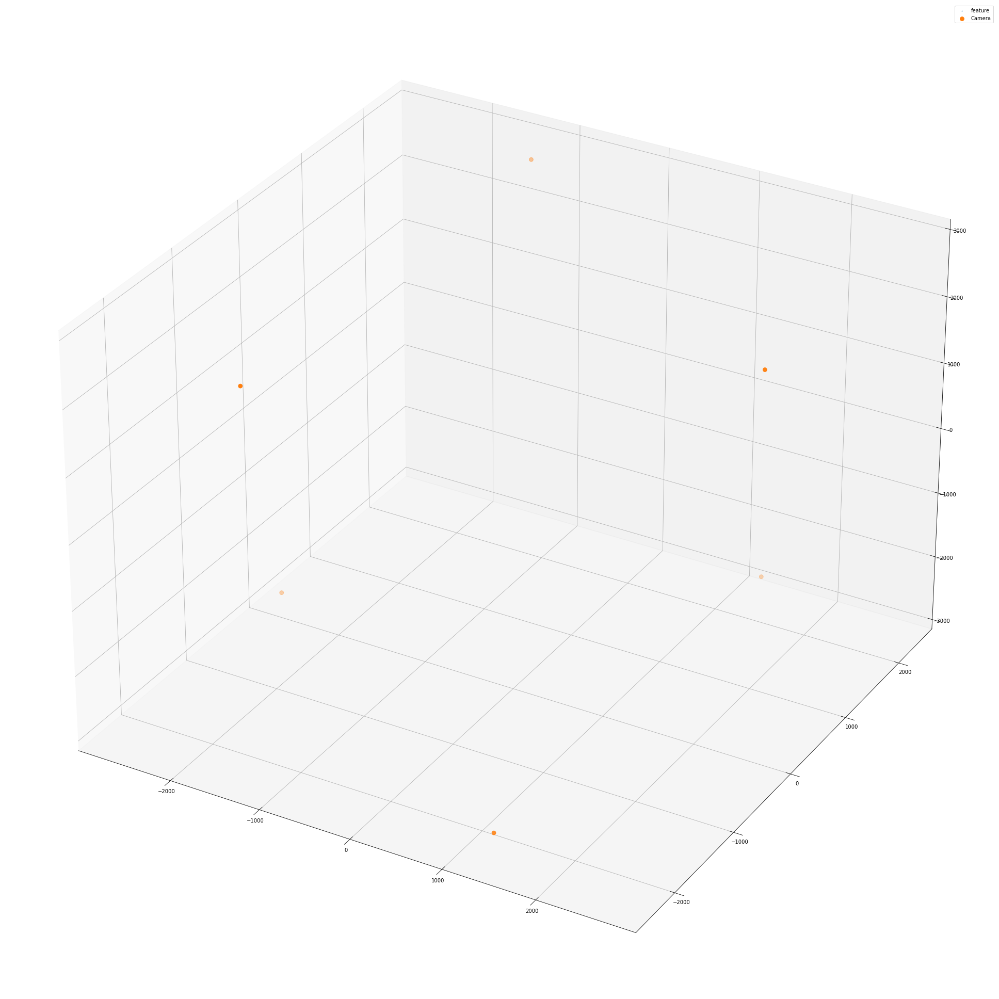

In [24]:
plot_geometry(bad_features, camera_positions)

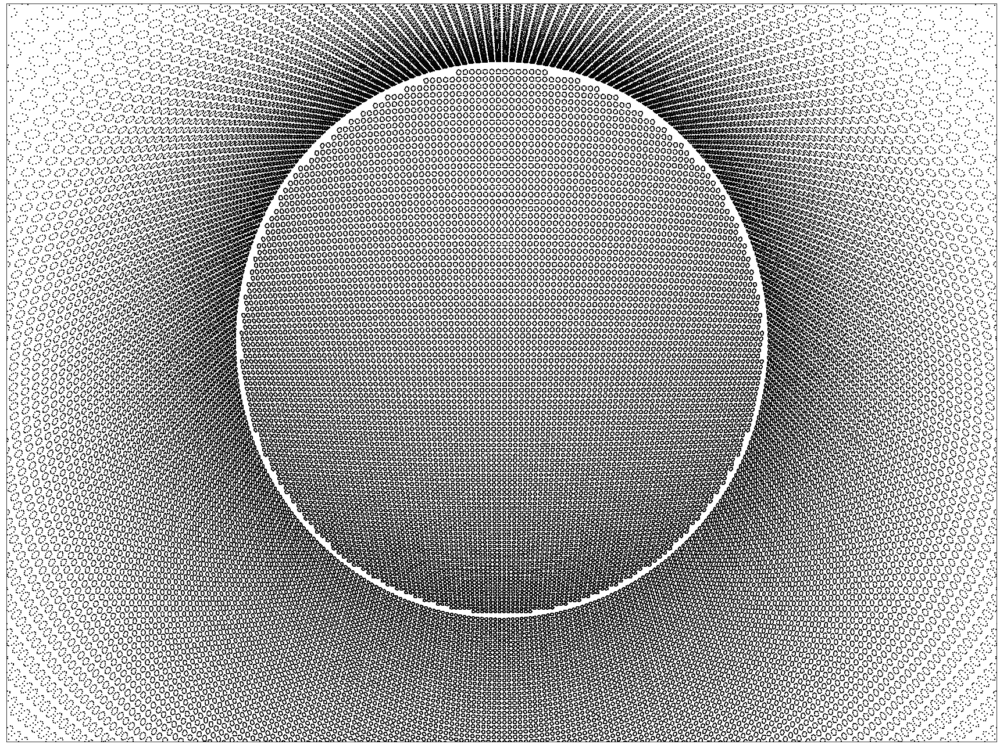

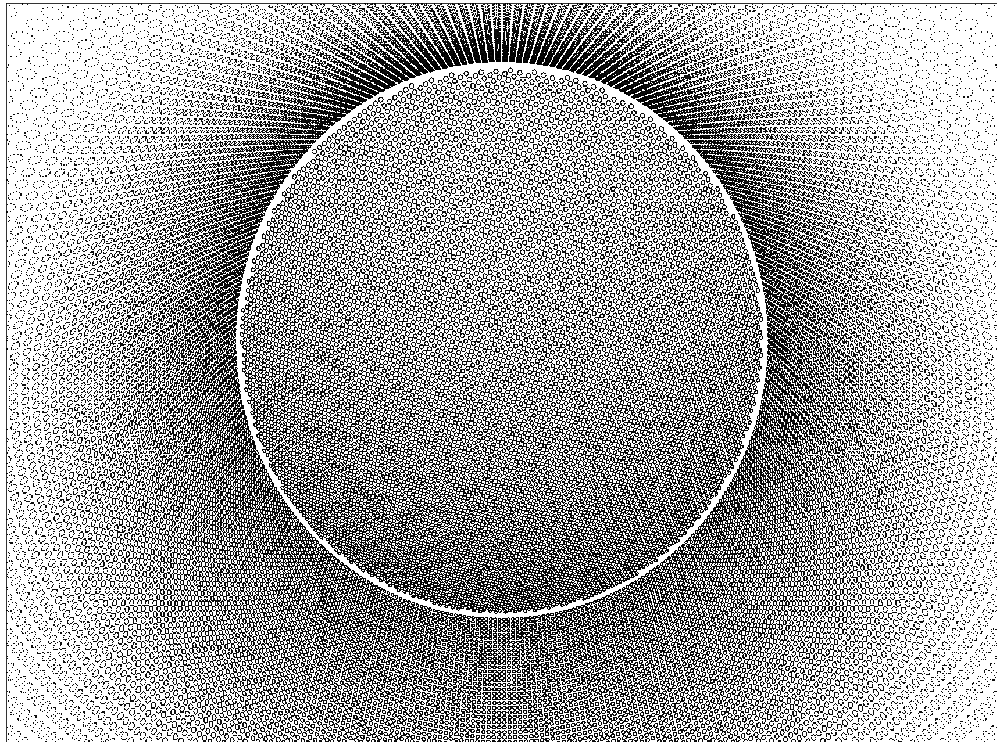

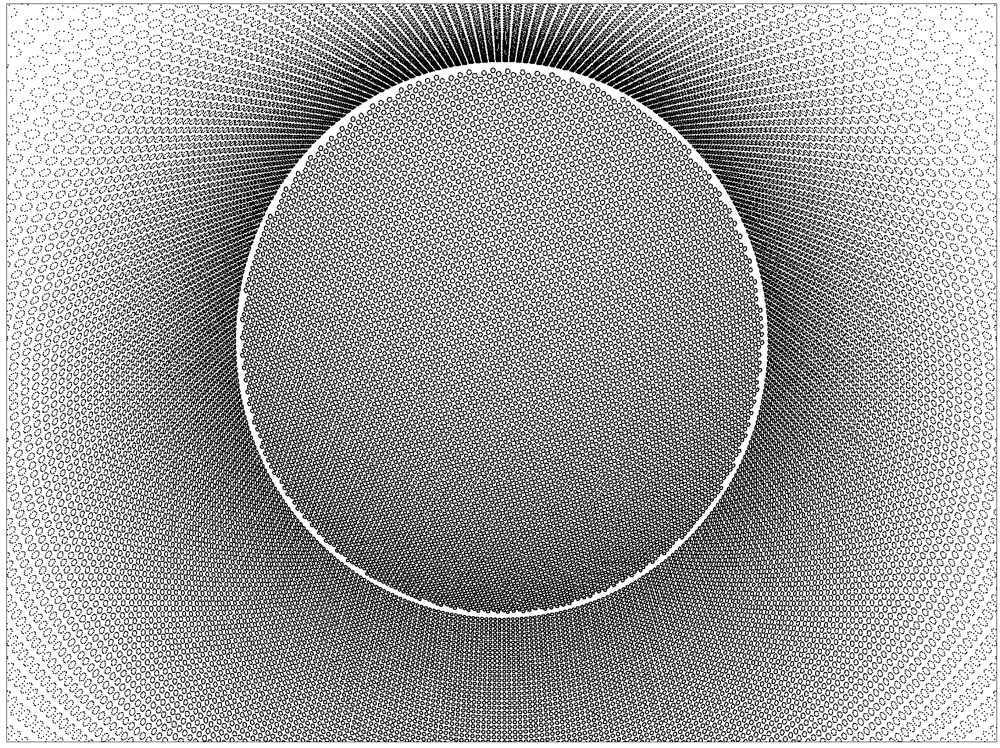

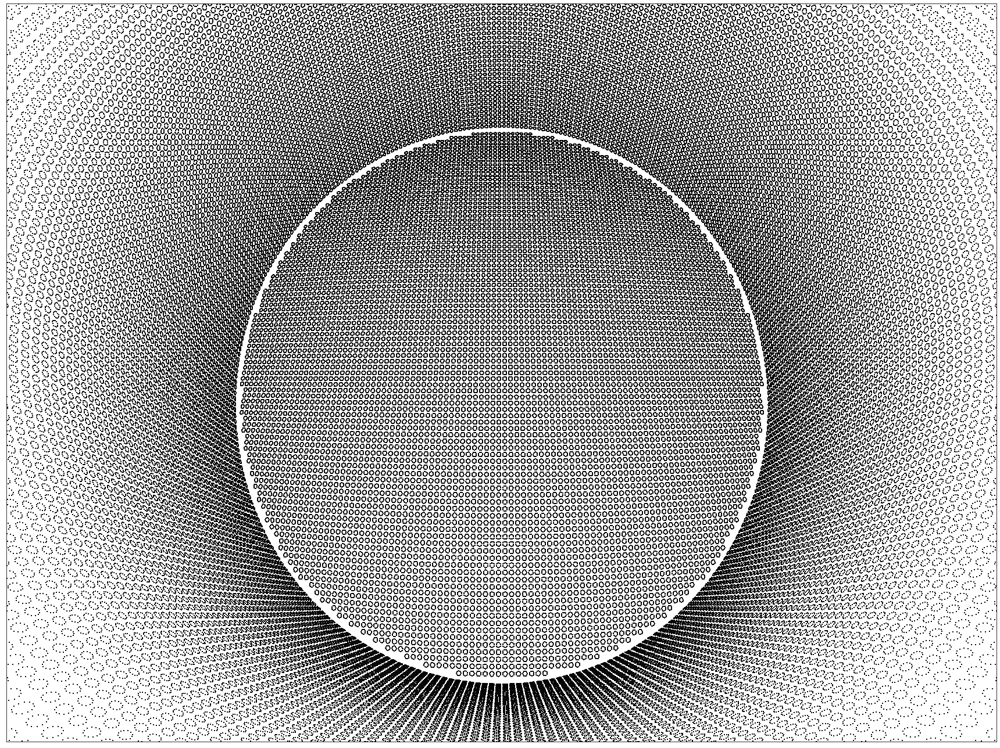

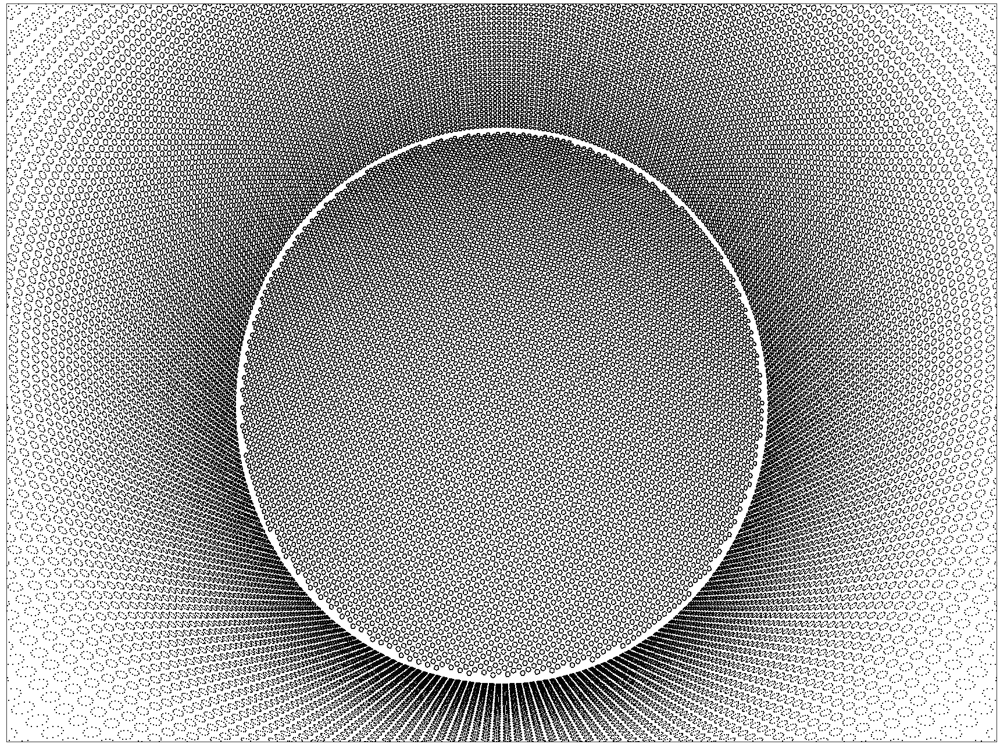

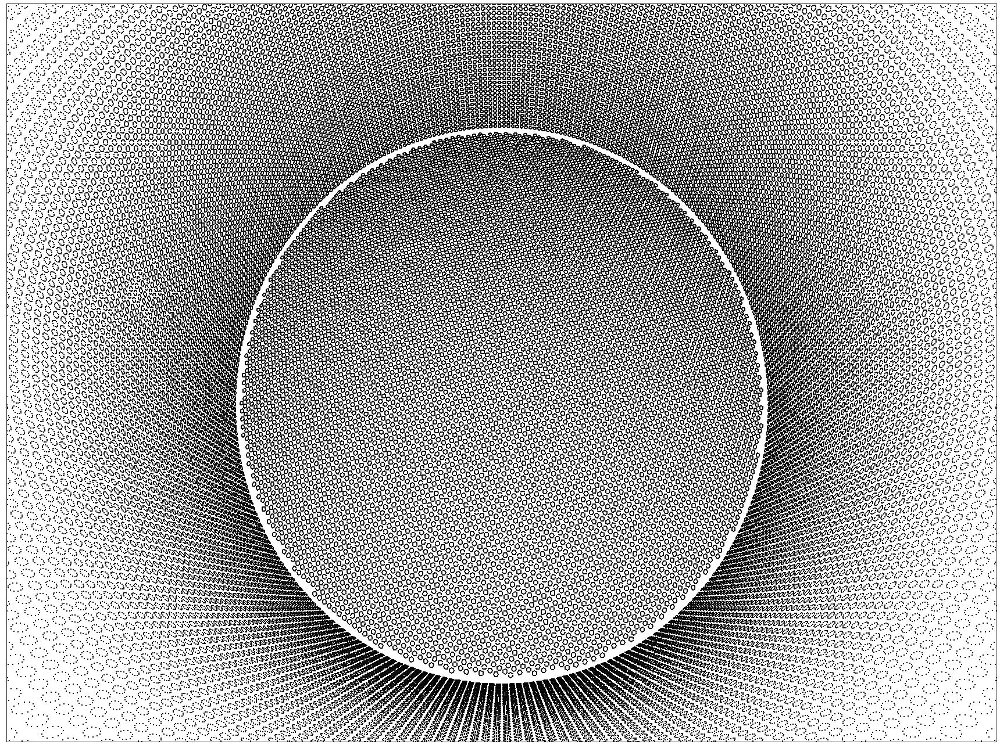

In [25]:
simulator.show_images(image_feature_locations, area=image_area, s=1, marker=',', figsize=(24,18))

In [172]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_6a_A6000_'+str(k)+'.png', v)

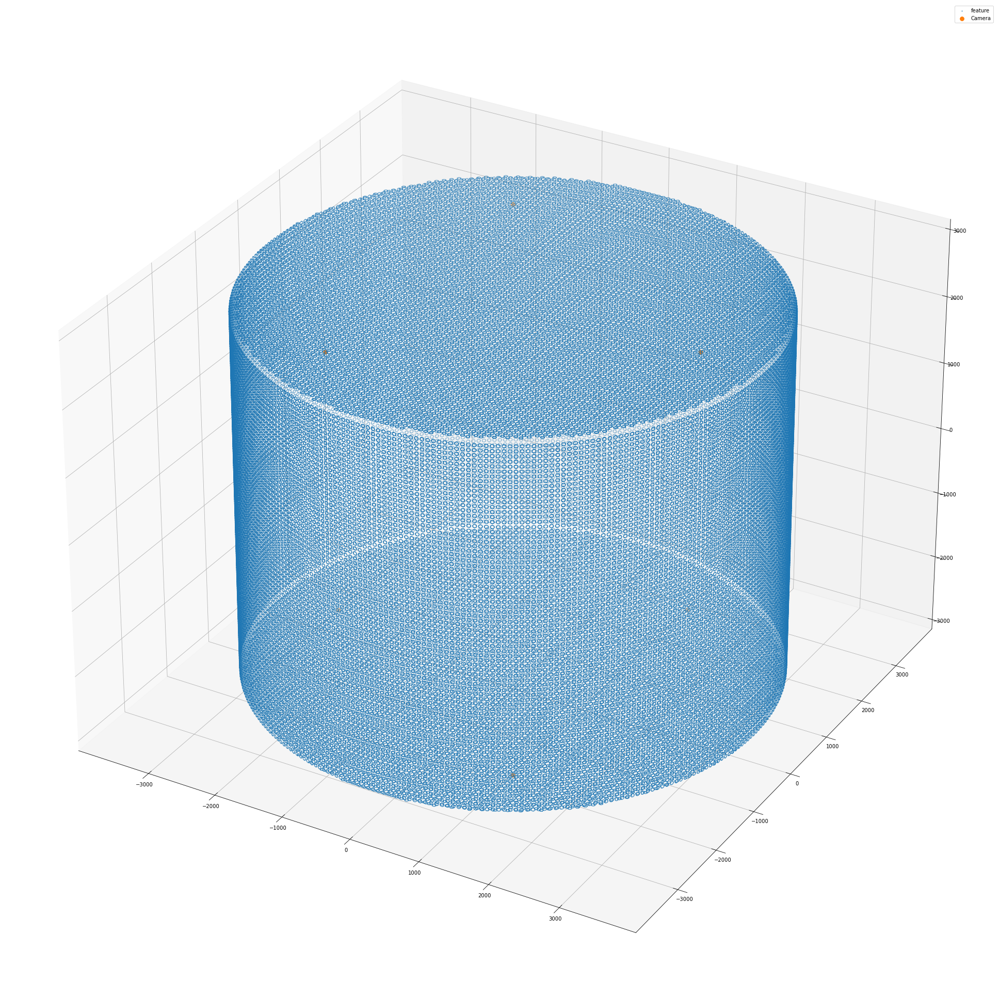

In [173]:
camera_orientations, camera_positions = fit.camera_world_poses(camera_rotations, camera_translations)
plot_geometry(feature_positions, camera_positions)

## 6 camera configuration B

In [174]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [ 0                     ,  0                     , -camera_halfz_position],
    [ 0                     ,  0                     ,  camera_halfz_position],
    [ camera_radial_position,  0                     ,  0                    ],
    [-camera_radial_position,  0                     ,  0                    ],
    [ 0                     ,  camera_radial_position,  0                    ],
    [ 0                     , -camera_radial_position,  0                    ]])
camera_directions = [[ 0,  0,  1],
                     [ 0,  0, -1],
                     [-1,  0,  0],
                     [ 1,  0,  0],
                     [ 0, -1,  0],
                     [ 0,  1,  0]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, np.pi/2, 0.0, 0.0, 0.0, 0.0])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [175]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({3: 333164, 4: 113200, 2: 14964, 5: 48})


In [176]:
{k: v/sum(feature_counts_counts.values()) for k,v in feature_counts_counts.items()}

{3: 0.7221095158829242,
 4: 0.2453530309335553,
 5: 0.00010403662089055348,
 2: 0.032433416562630046}

In [177]:
sum(k*v for k,v in feature_counts_counts.items())/len(feature_positions)

3.2131276876127064

In [178]:
bad_features = {f:v for f, v in feature_positions.items() if feature_counts[f]<3}

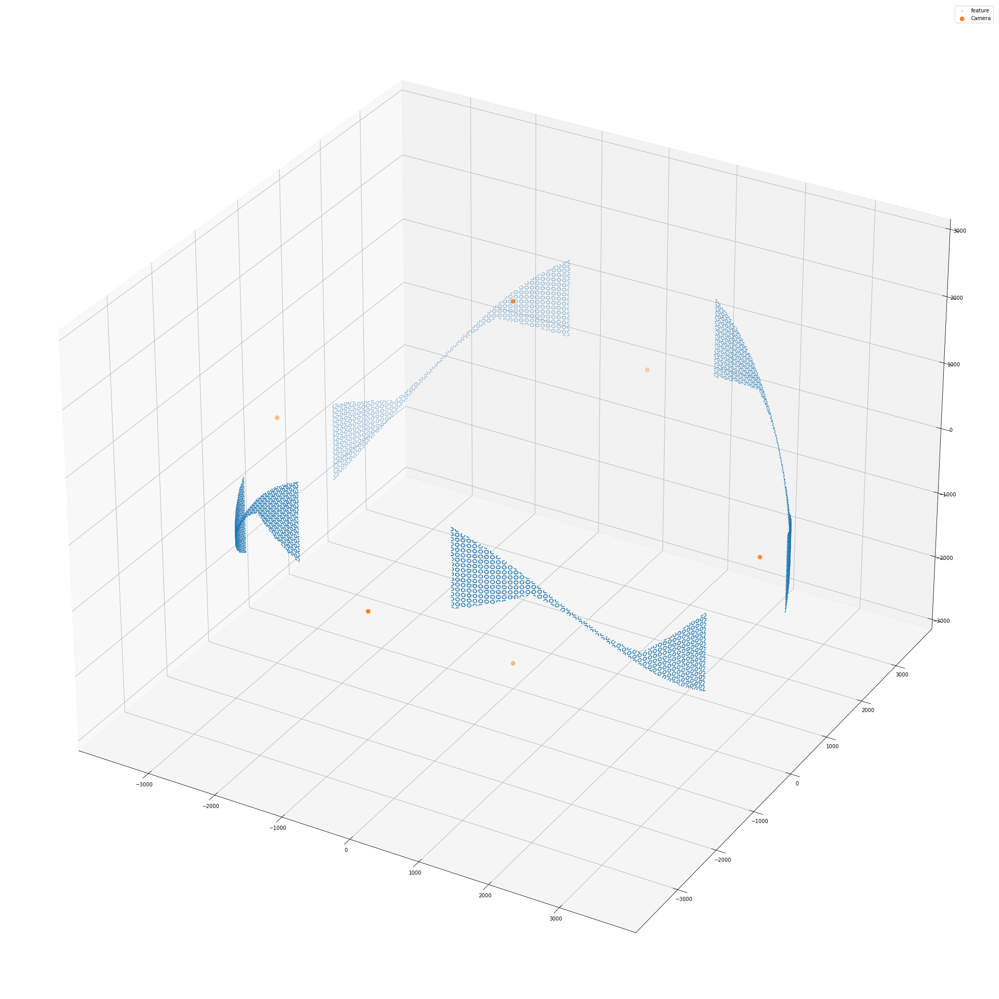

In [179]:
plot_geometry(bad_features, camera_positions)

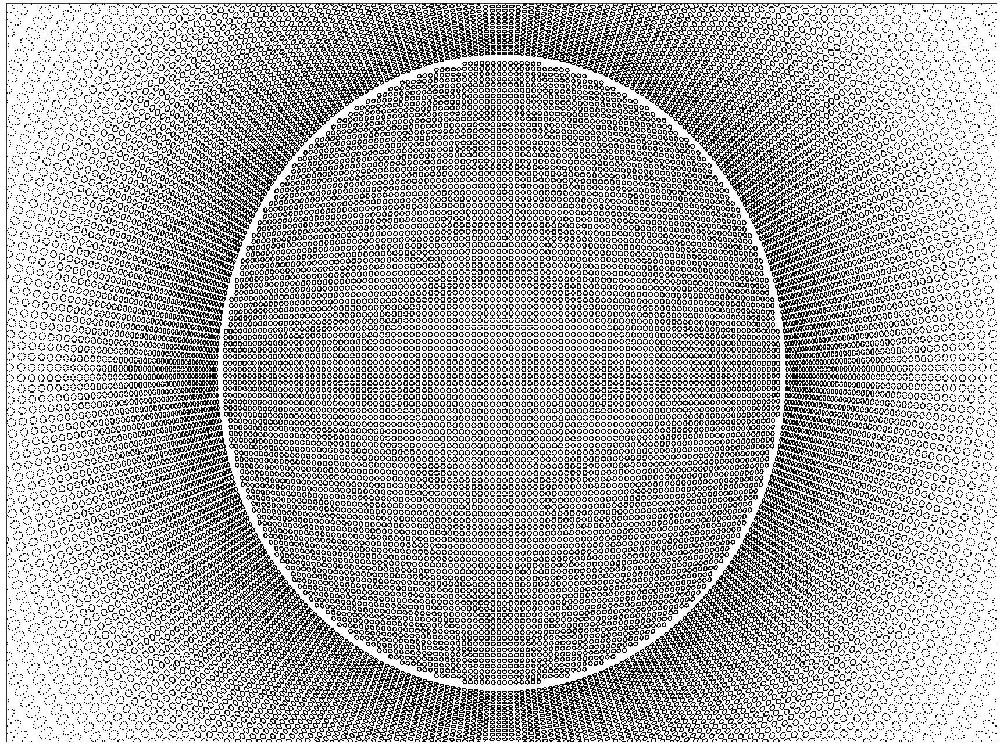

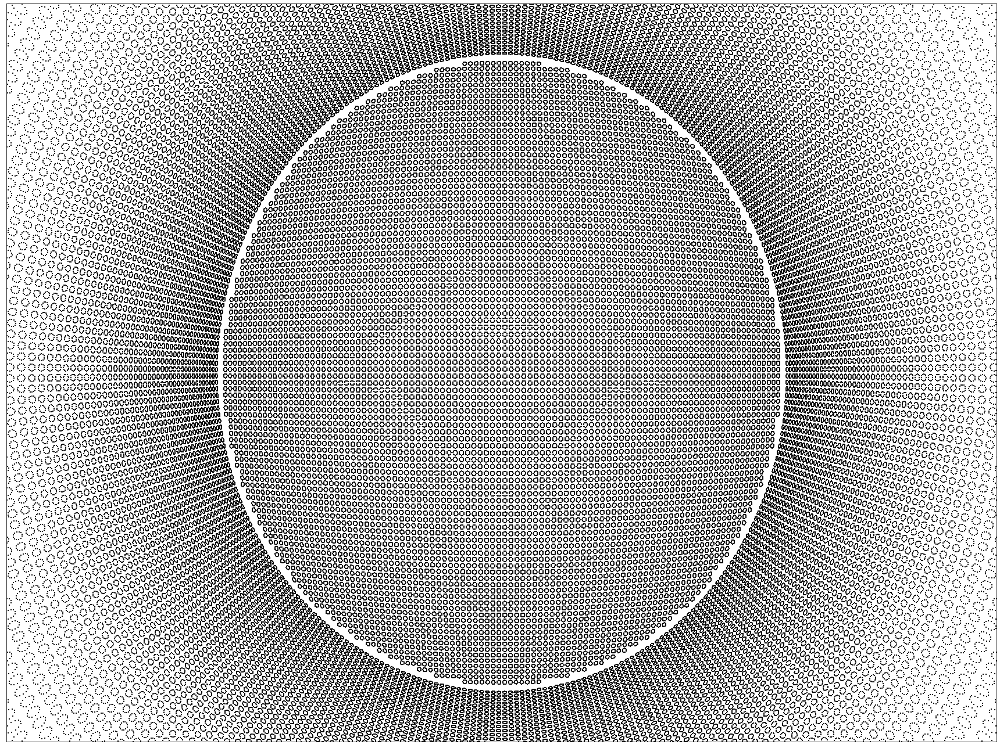

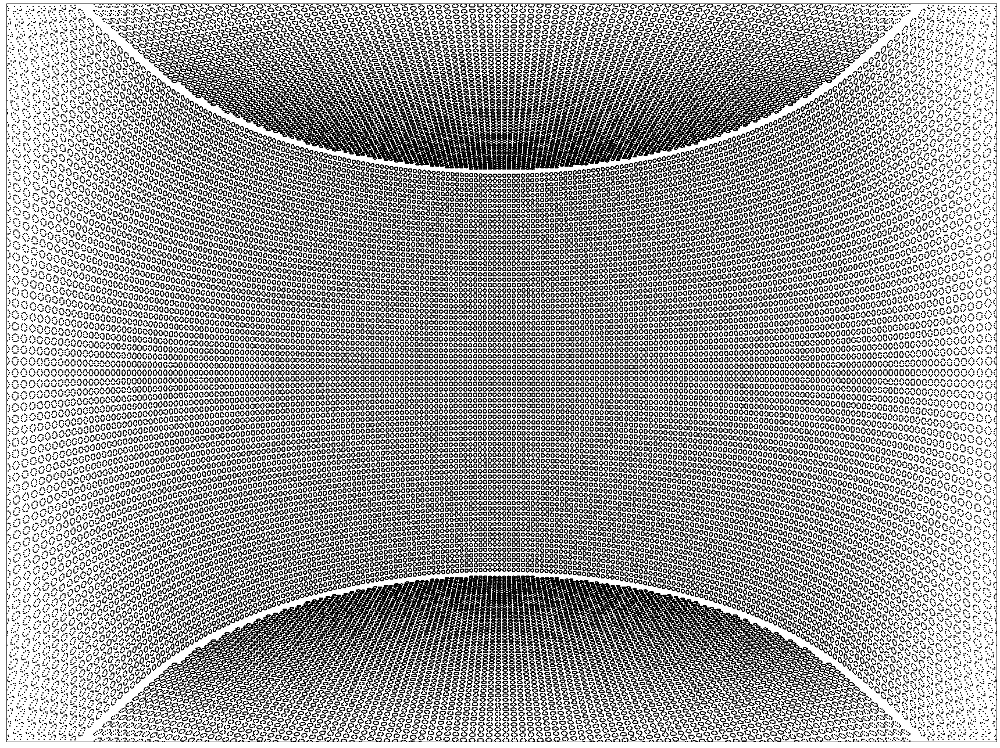

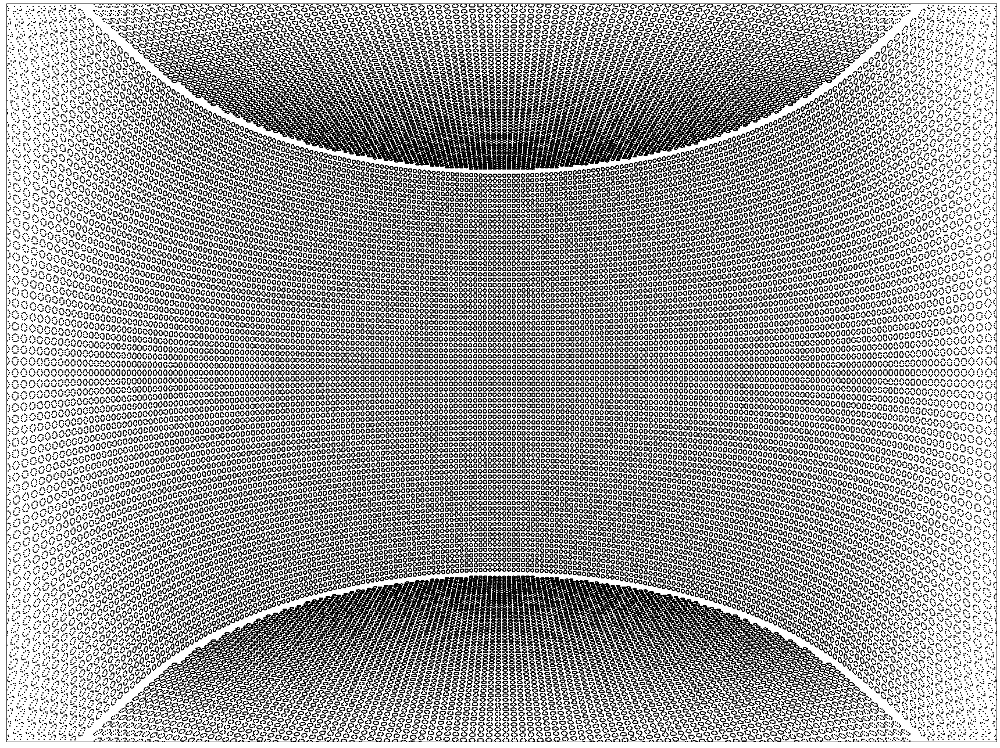

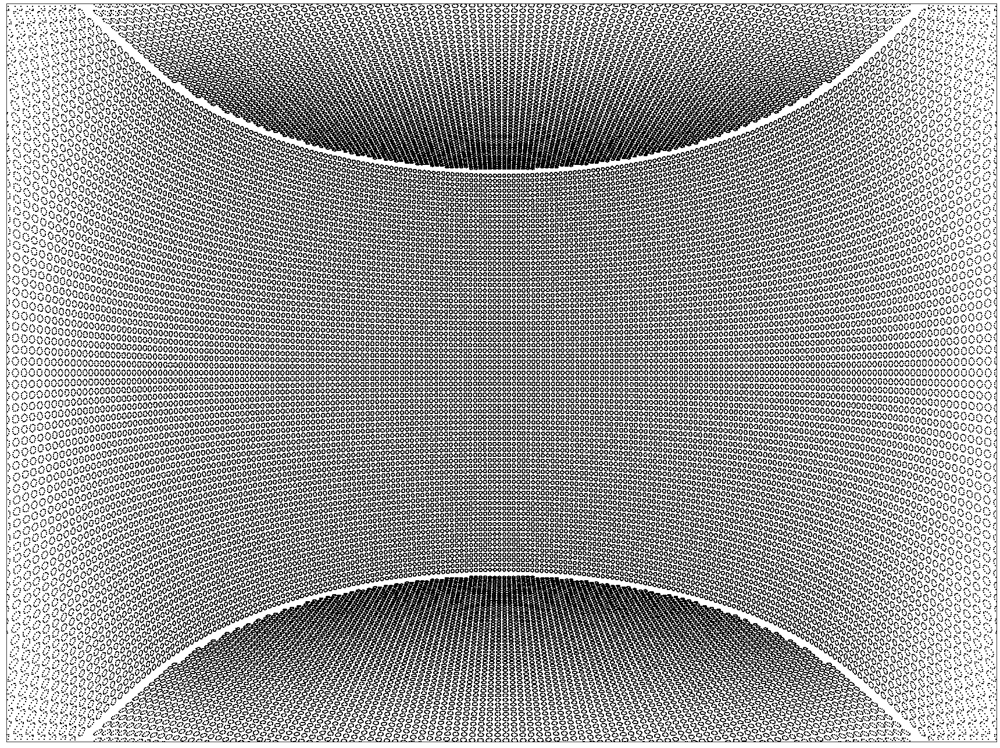

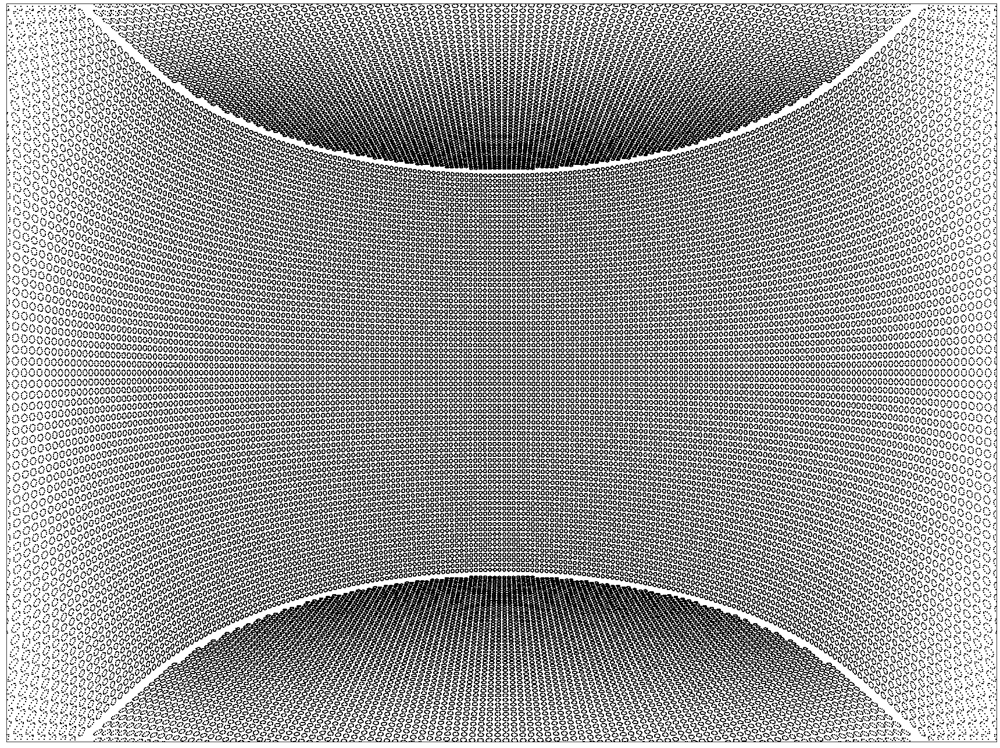

In [180]:
simulator.show_images(image_feature_locations, area=image_area, s=1, marker=',', figsize=(24,18))

In [181]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_6b_A6000_'+str(k)+'.png', v)

## 8 camera configuration A

In [182]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [-camera_radial_position,  0                     , -camera_halfz_position],
    [camera_radial_position ,  0                     , -camera_halfz_position],
    [0                      , -camera_radial_position, -camera_halfz_position],
    [0                      ,  camera_radial_position, -camera_halfz_position],
    [-camera_radial_position,  0                     ,  camera_halfz_position],
    [camera_radial_position ,  0                     ,  camera_halfz_position],
    [0                      , -camera_radial_position,  camera_halfz_position],
    [0                      ,  camera_radial_position,  camera_halfz_position]])
camera_directions = [[ 1,  0,  1.],
                     [-1,  0,  1.],
                     [ 0,  1,  1.],
                     [ 0, -1,  1.],
                     [ 1,  0, -1.],
                     [-1,  0, -1.],
                     [ 0,  1, -1.],
                     [ 0, -1, -1.]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0])#[np.pi/2, np.pi/2, np.pi/2, np.pi/2])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [183]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({4: 194600, 6: 102096, 8: 63488, 3: 40592, 7: 34464, 5: 26136})


In [184]:
{k: v/sum(feature_counts_counts.values()) for k,v in feature_counts_counts.items()}

{5: 0.05664794007490637,
 4: 0.4217818005271189,
 6: 0.22128589263420725,
 7: 0.07469829379941739,
 8: 0.13760577056457207,
 3: 0.08798030239977805}

In [185]:
sum(k*v for k,v in feature_counts_counts.items())/len(feature_positions)

5.185757386600083

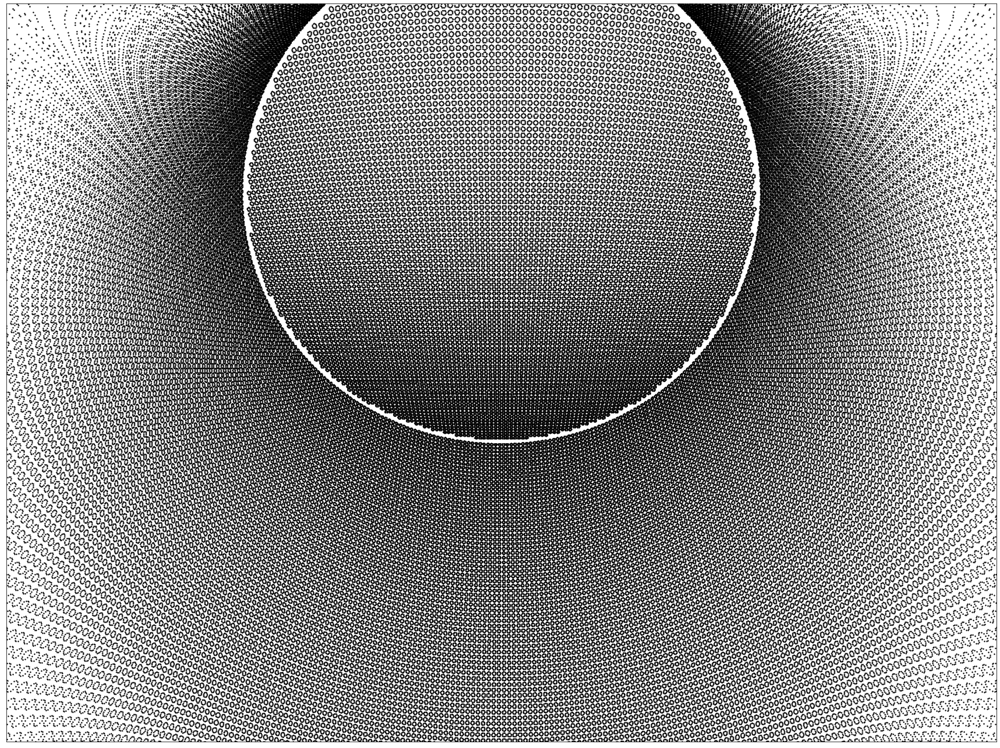

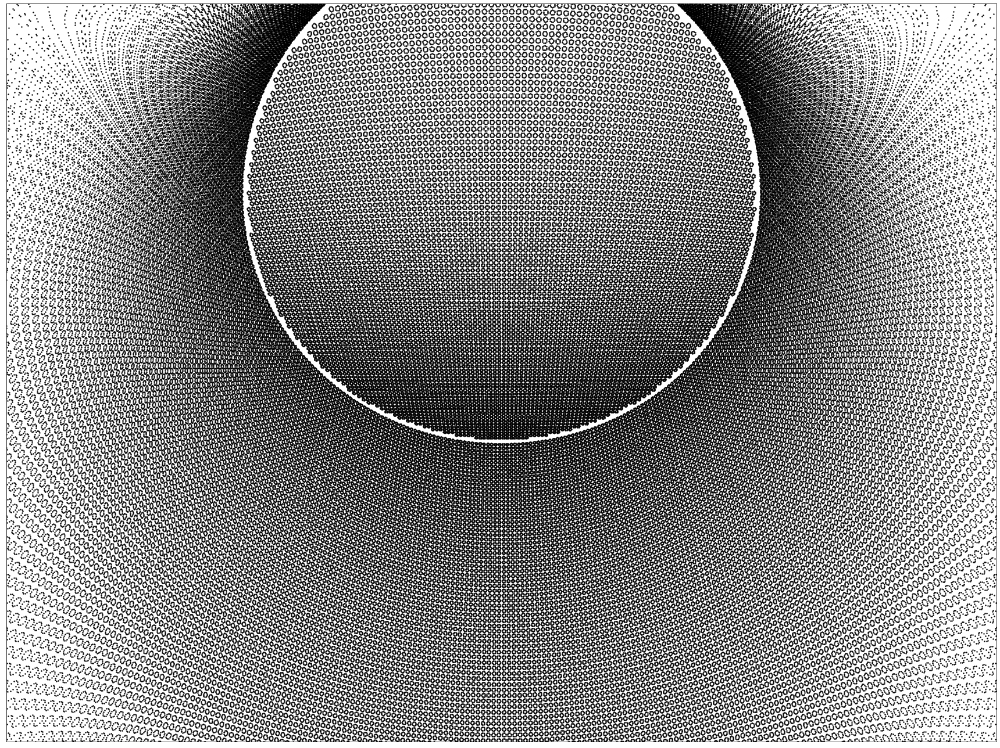

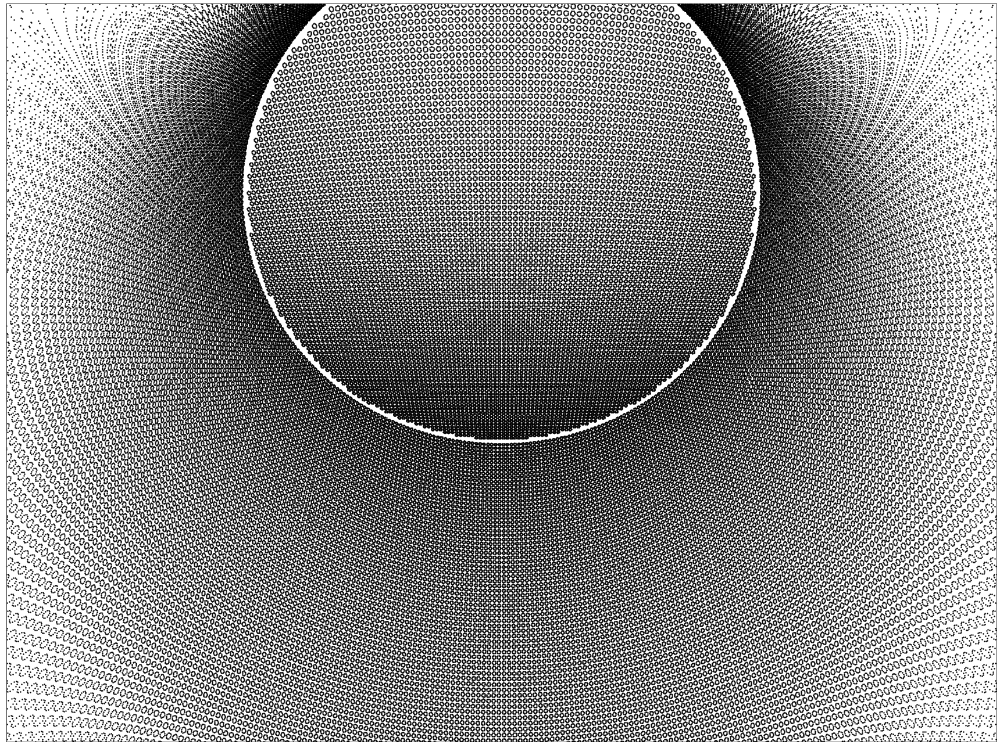

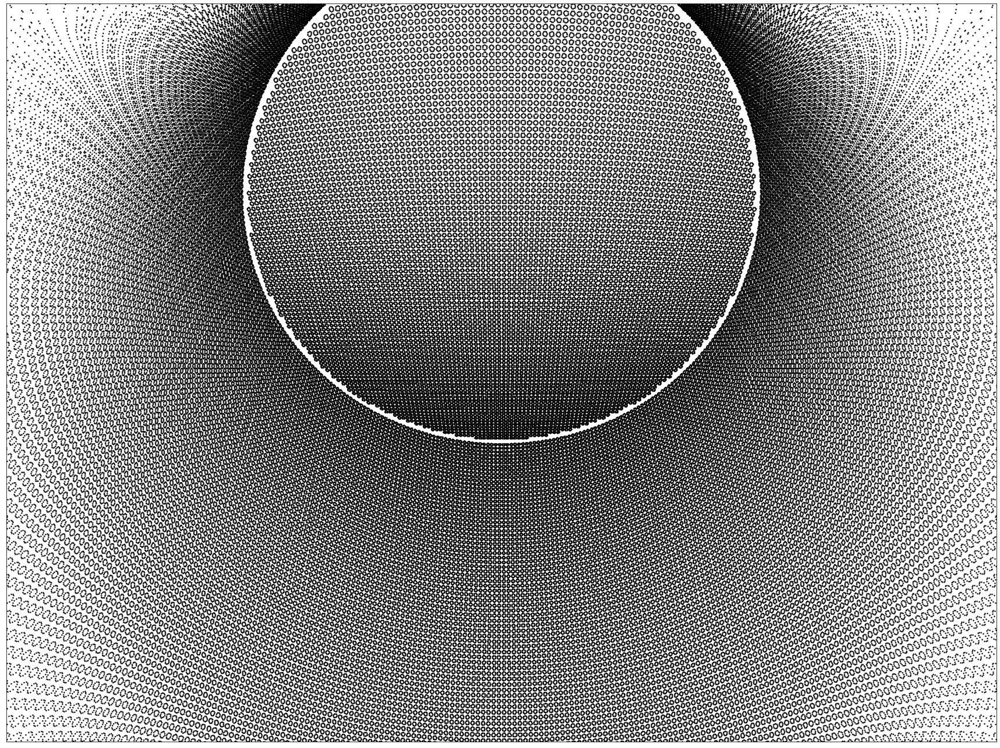

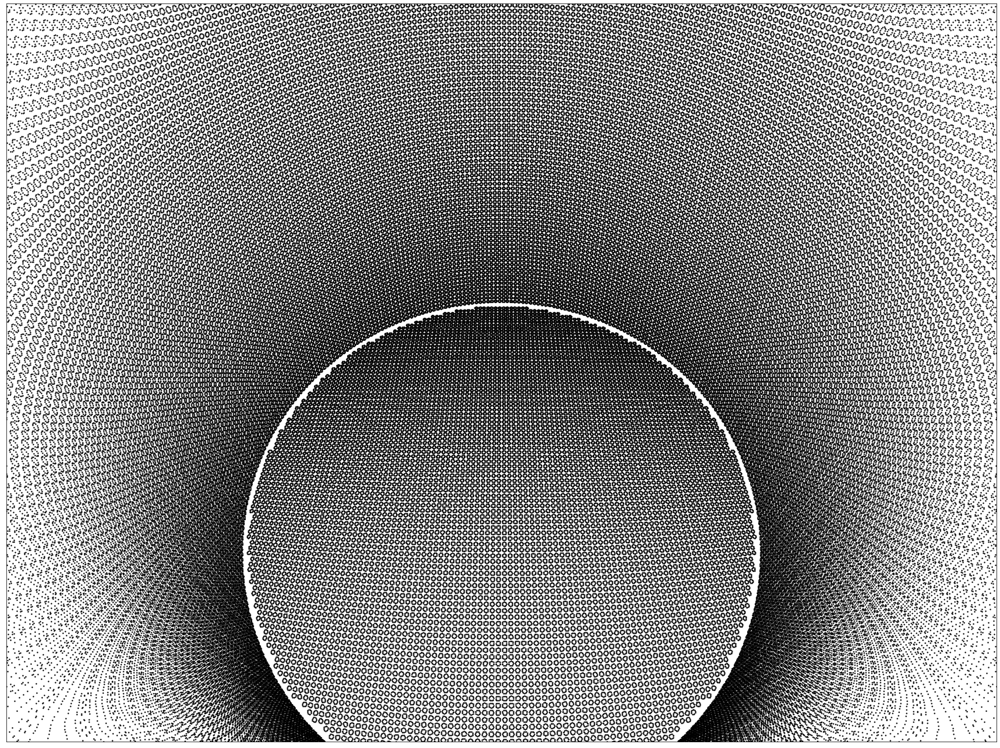

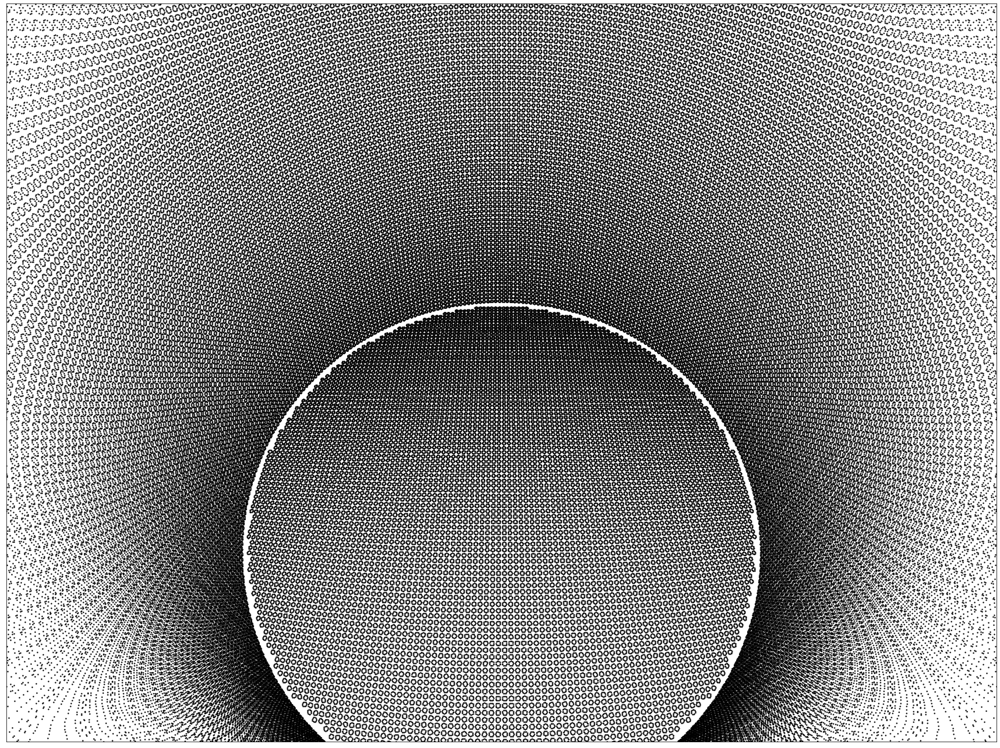

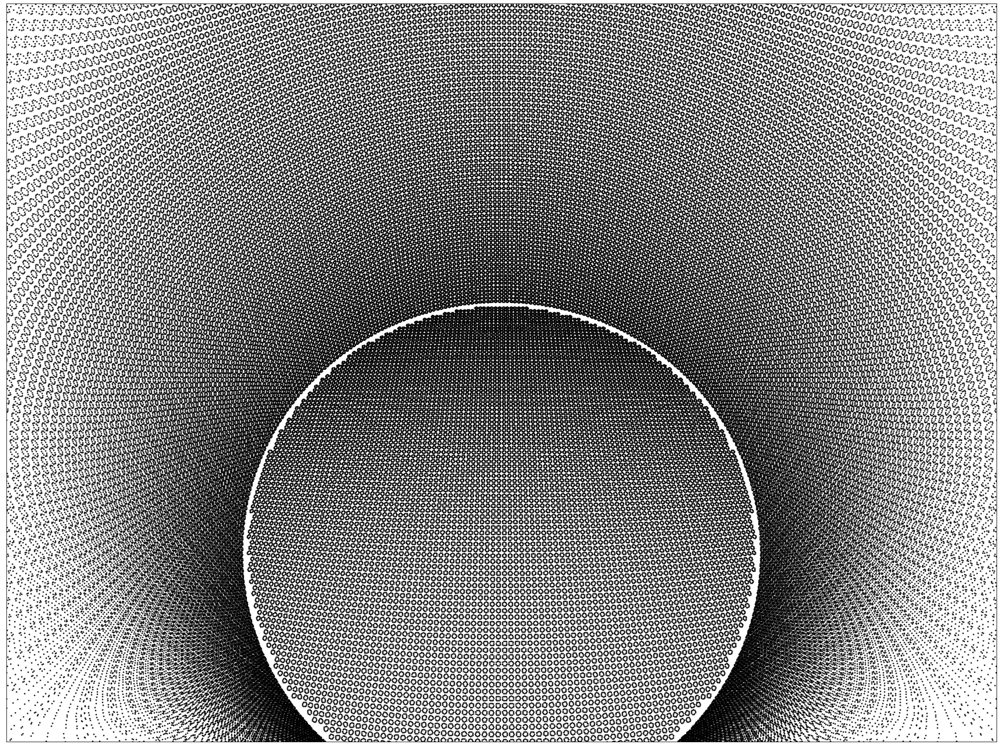

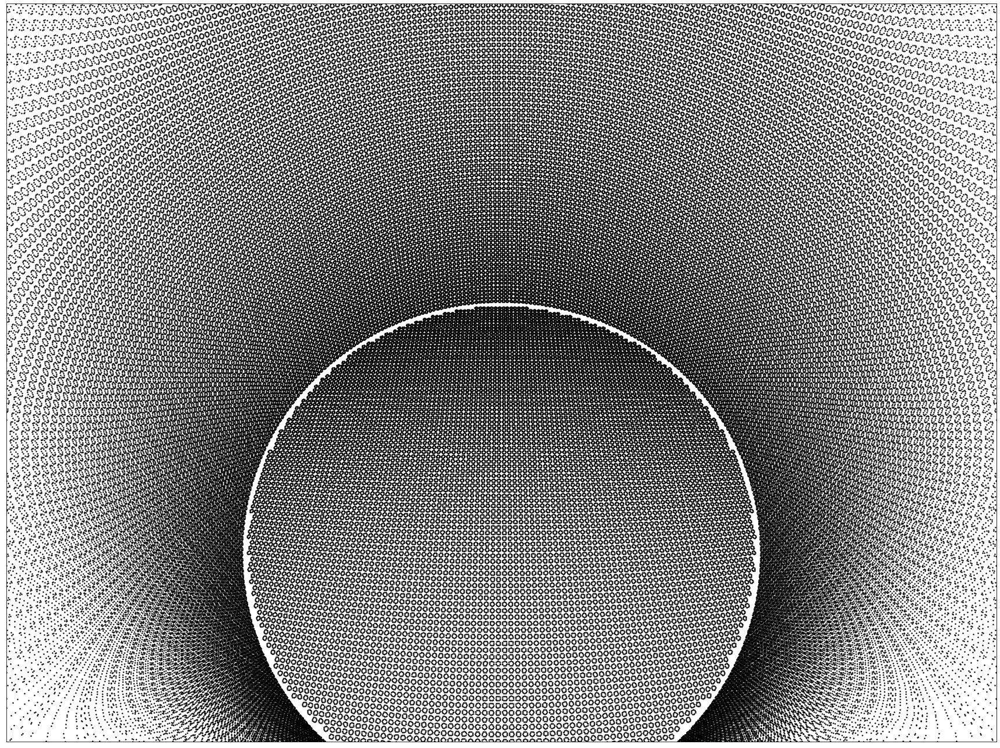

In [186]:
simulator.show_images(image_feature_locations, area=image_area, figsize=(24,18))

In [187]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_8a_A6000_'+str(k)+'.png', v)

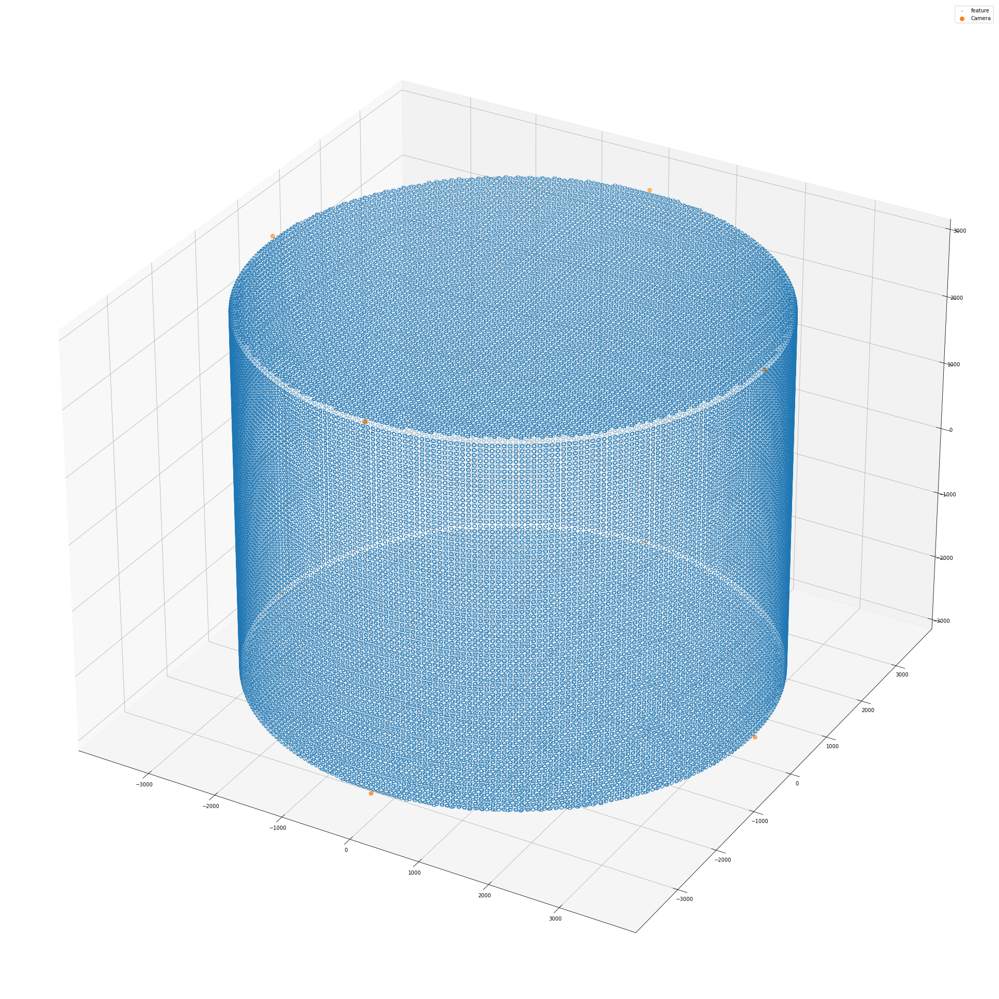

In [188]:
camera_orientations, camera_positions = fit.camera_world_poses(camera_rotations, camera_translations)
plot_geometry(feature_positions, camera_positions)

## 8 camera configuration B

In [191]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [ 0                                  ,      0                     ,     -camera_halfz_position],
    [ 0                                  ,      0                     ,      camera_halfz_position],
    [ 0                                  ,     -camera_radial_position, -0.3*camera_halfz_position],
    [ camera_radial_position*np.sqrt(3)/2,  0.5*camera_radial_position, -0.3*camera_halfz_position],
    [-camera_radial_position*np.sqrt(3)/2,  0.5*camera_radial_position, -0.3*camera_halfz_position],
    [ 0                                  ,      camera_radial_position,  0.3*camera_halfz_position],
    [ camera_radial_position*np.sqrt(3)/2, -0.5*camera_radial_position,  0.3*camera_halfz_position],
    [-camera_radial_position*np.sqrt(3)/2, -0.5*camera_radial_position,  0.3*camera_halfz_position]])
camera_directions = [[ 0           ,  0  ,    1],
                     [ 0           ,  0  ,   -1],
                     [ 0           ,  1  ,  0.3],
                     [-np.sqrt(3)/2, -0.5,  0.3],
                     [ np.sqrt(3)/2, -0.5,  0.3],
                     [ 0           , -1  , -0.3],
                     [-np.sqrt(3)/2,  0.5, -0.3],
                     [ np.sqrt(3)/2,  0.5, -0.3]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, np.pi/2, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0])#[np.pi/2, np.pi/2, np.pi/2, np.pi/2])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [192]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({4: 260154, 5: 175152, 3: 20996, 6: 5074})


In [193]:
{k: v/sum(feature_counts_counts.values()) for k,v in feature_counts_counts.items()}

{5: 0.37962962962962965,
 4: 0.5638654806491885,
 6: 0.010997537799972257,
 3: 0.045507351921209596}

In [194]:
sum(k*v for k,v in feature_counts_counts.items())/len(feature_positions)

4.356117353308364

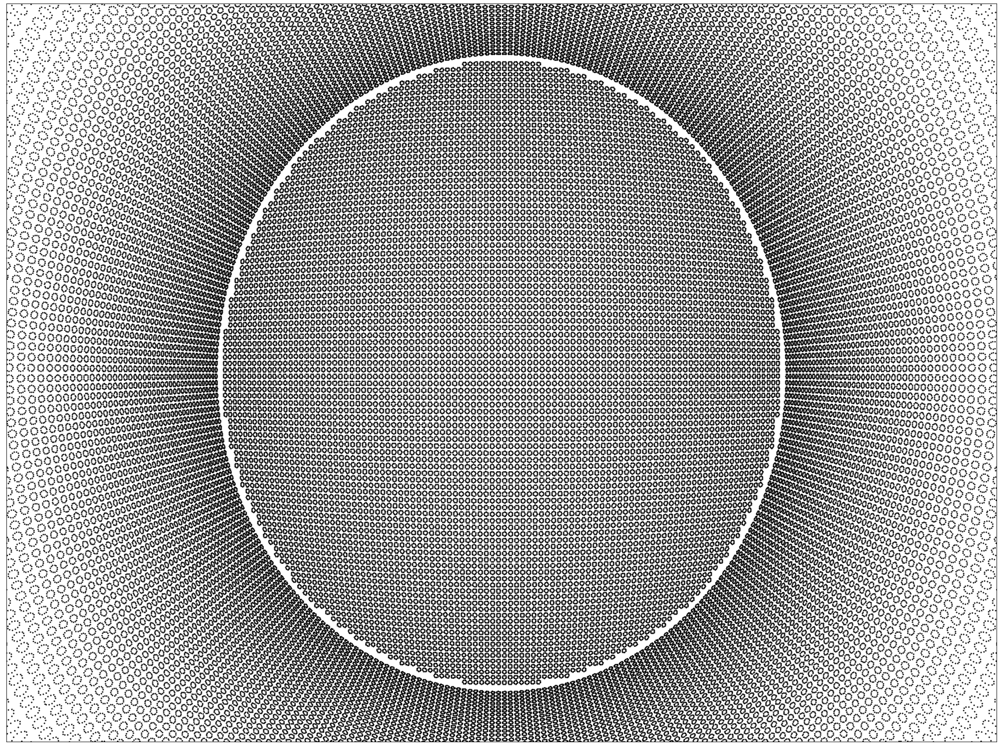

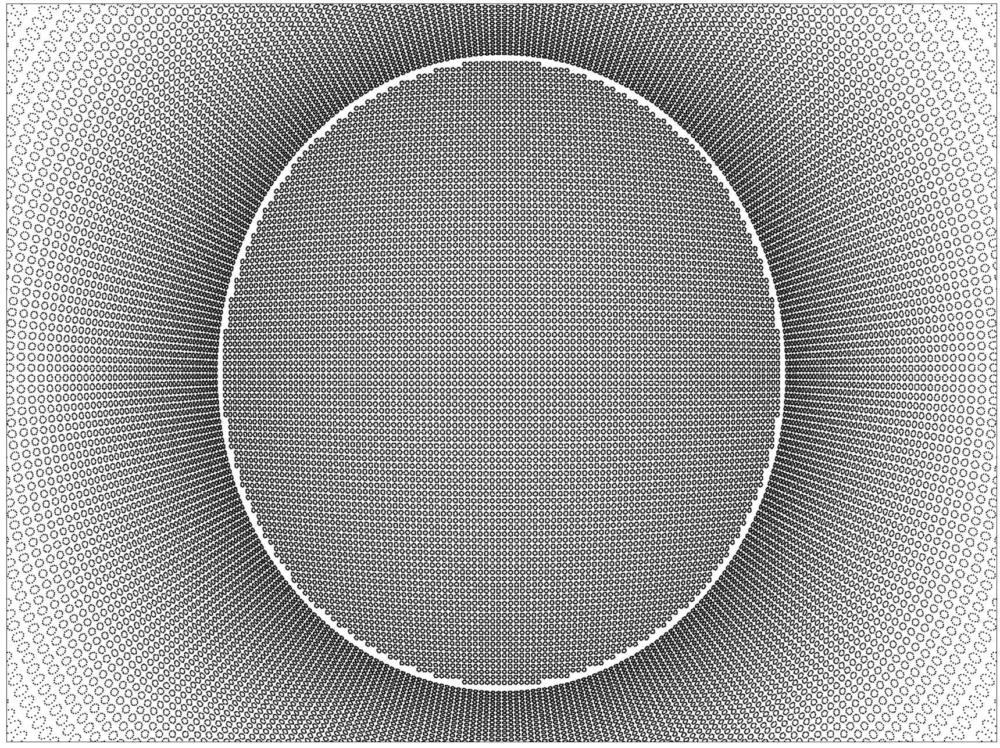

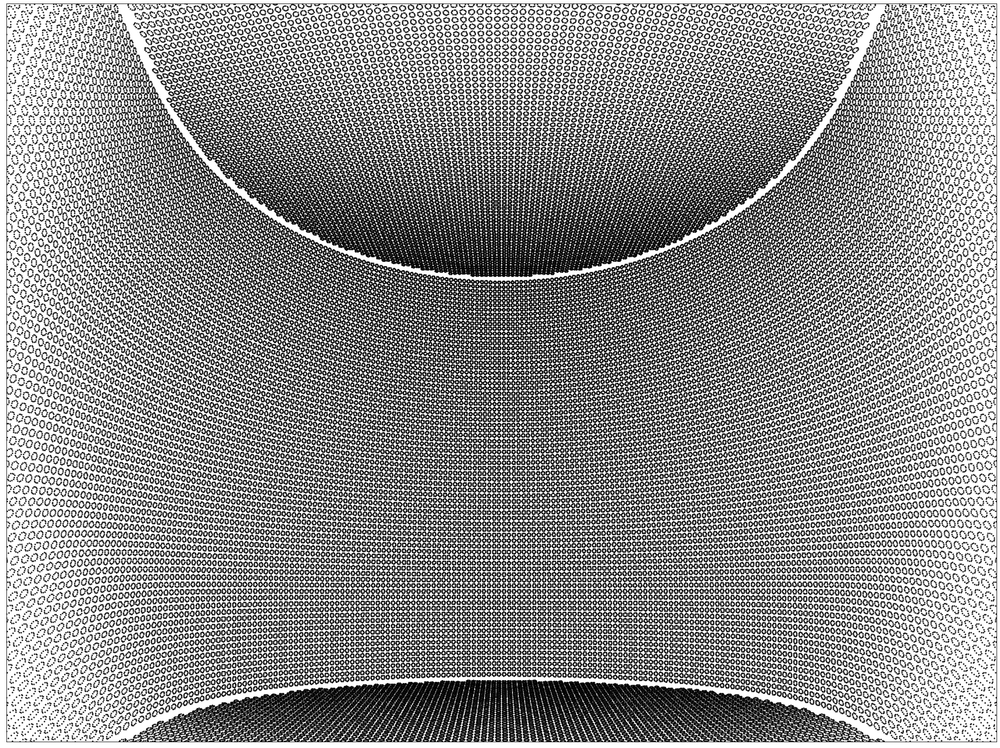

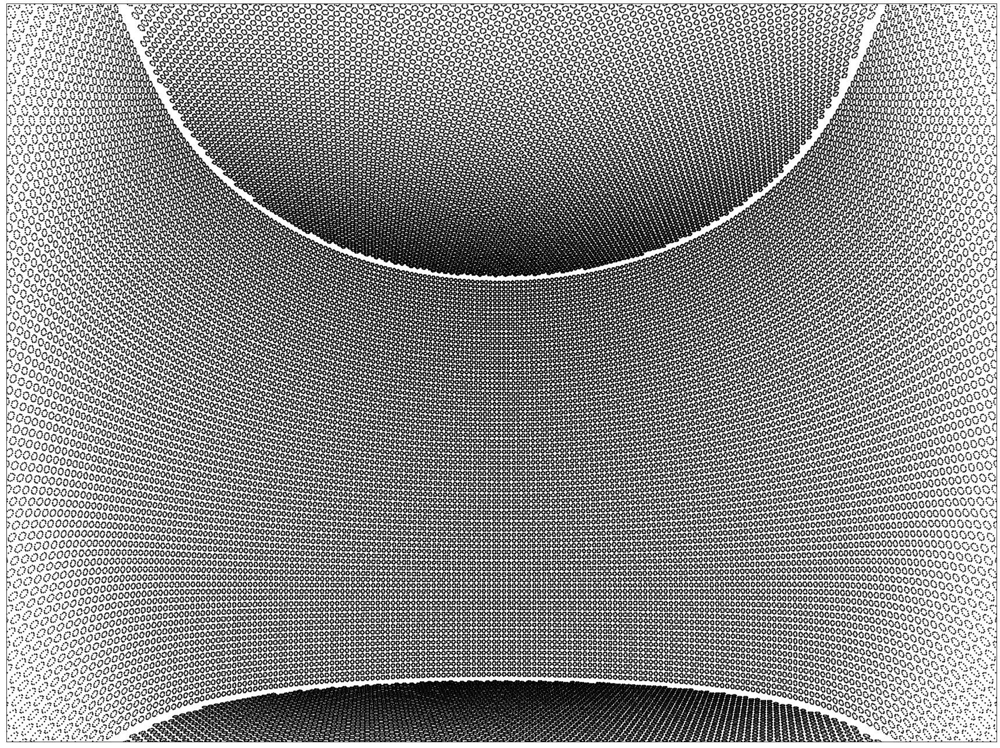

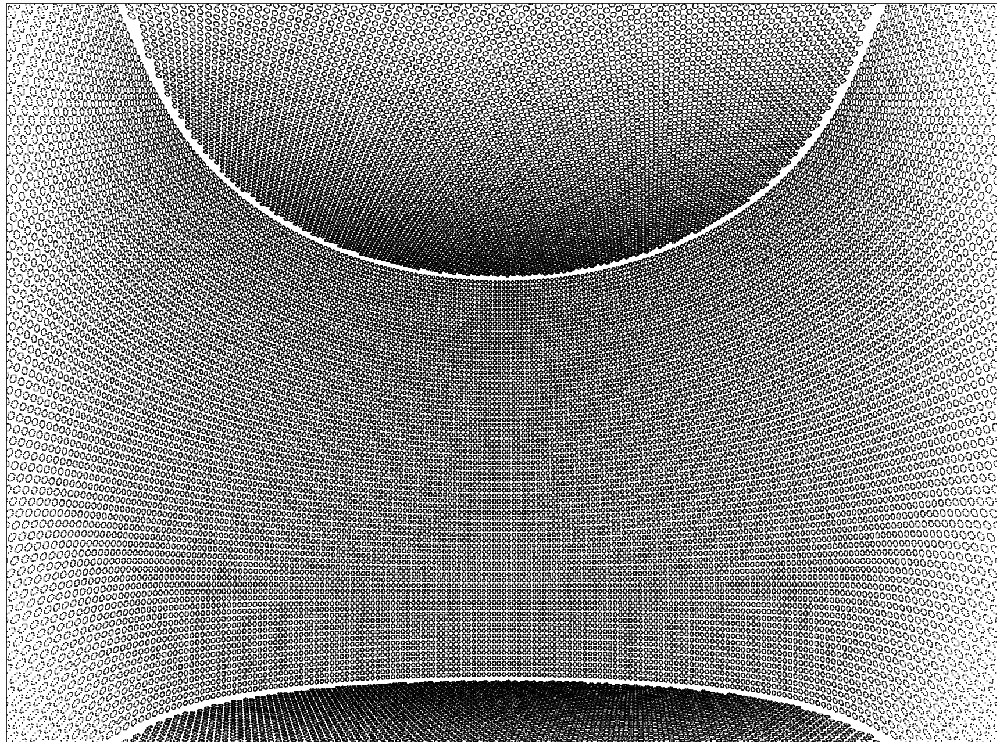

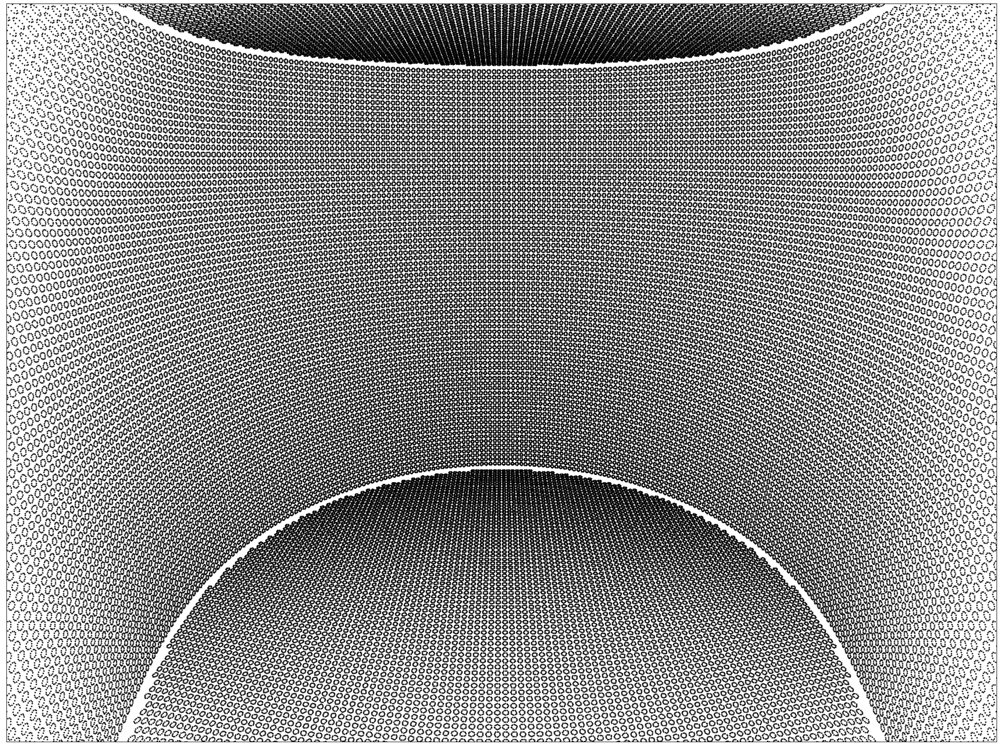

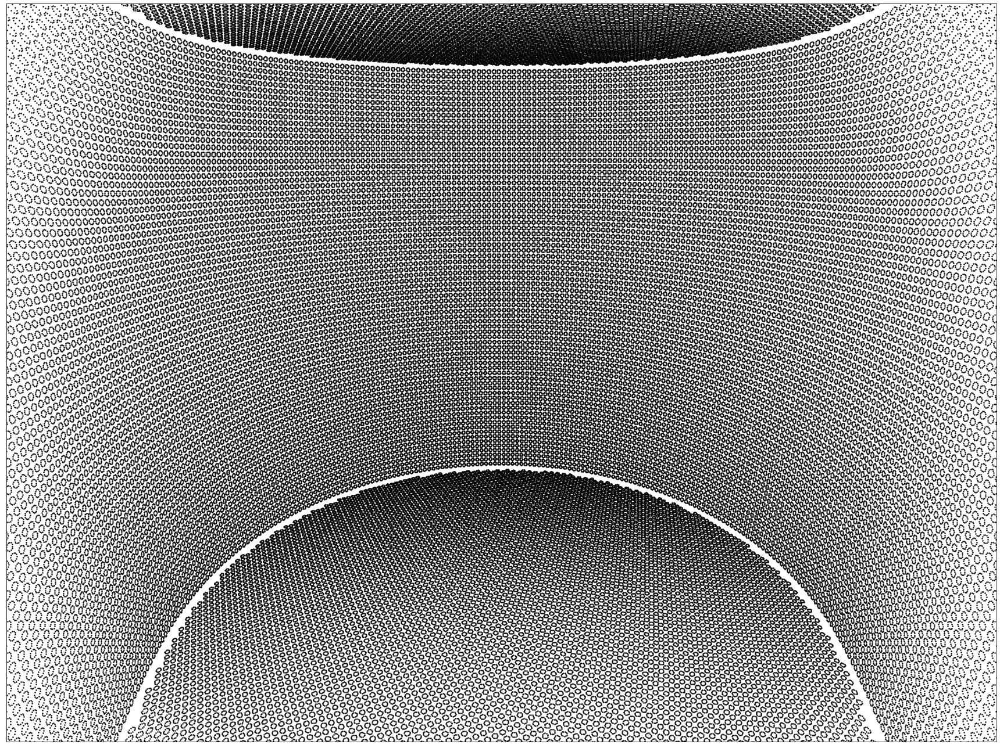

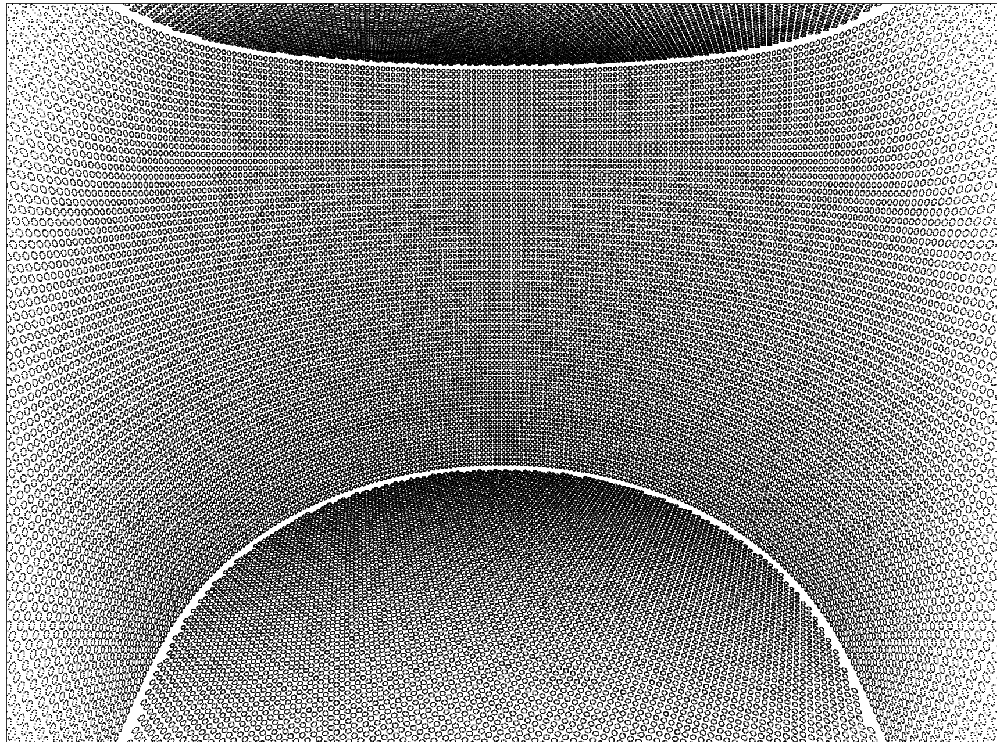

In [195]:
simulator.show_images(image_feature_locations, area=image_area, figsize=(24,18))

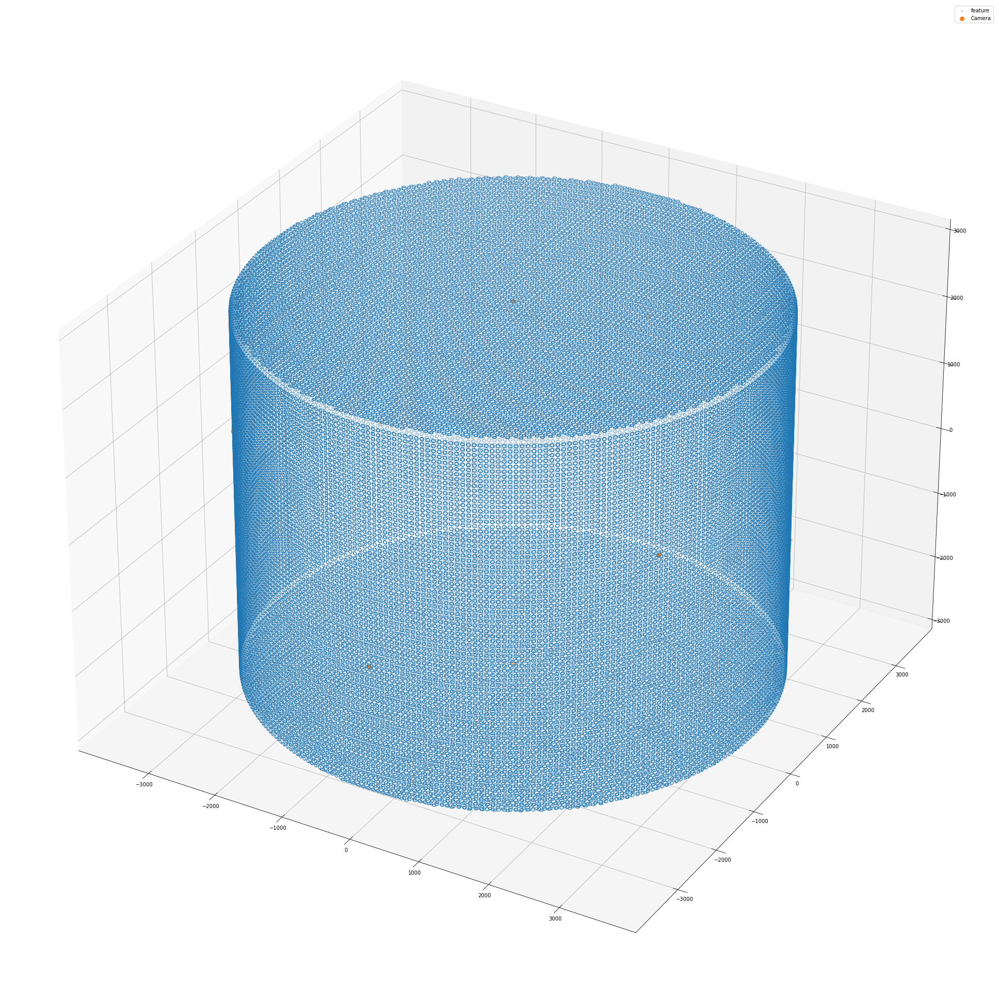

In [196]:
camera_orientations, camera_positions = fit.camera_world_poses(camera_rotations, camera_translations)
plot_geometry(feature_positions, camera_positions)

In [197]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_8b_A6000_'+str(k)+'.png', v)

## 8 camera configuration C

In [198]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [ 0                           ,  camera_radial_position*0.255, -camera_halfz_position],
    [ 0                           , -camera_radial_position*0.255, -camera_halfz_position],
    [ camera_radial_position*0.255,  0                           ,  camera_halfz_position],
    [-camera_radial_position*0.255,  0                           ,  camera_halfz_position],
    [ camera_radial_position      ,  0                           ,  0                    ],
    [-camera_radial_position      ,  0                           ,  0                    ],
    [ 0                           ,  camera_radial_position      ,  0                    ],
    [ 0                           , -camera_radial_position      ,  0                    ]])
camera_directions = [[ 0,  0,  1],
                     [ 0,  0,  1],
                     [ 0,  0, -1],
                     [ 0,  0, -1],
                     [-1,  0,  0],
                     [ 1,  0,  0],
                     [ 0, -1,  0],
                     [ 0,  1,  0]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, 0.0, np.pi/2, np.pi/2, 0.0, 0.0, 0.0, 0.0])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [199]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({4: 308744, 5: 95780, 3: 56804, 6: 48})


In [200]:
{k: v/sum(feature_counts_counts.values()) for k,v in feature_counts_counts.items()}

{4: 0.6691808850048551,
 5: 0.2075964072686919,
 3: 0.12311867110556249,
 6: 0.00010403662089055348}

In [201]:
sum(k*v for k,v in feature_counts_counts.items())/len(feature_positions)

4.0846858094049106

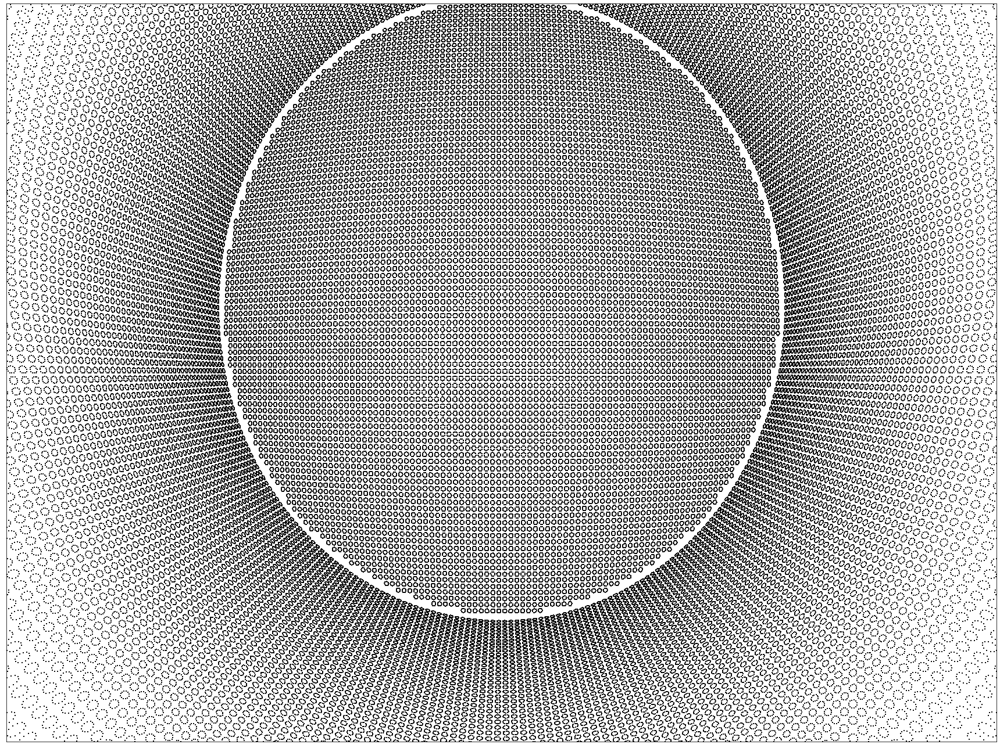

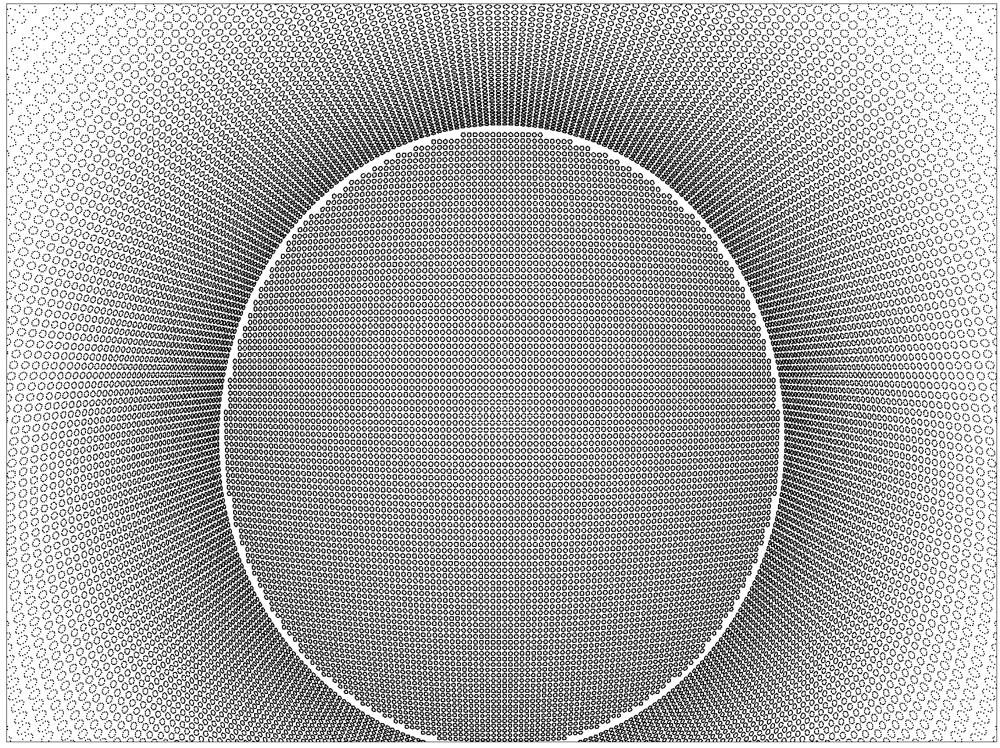

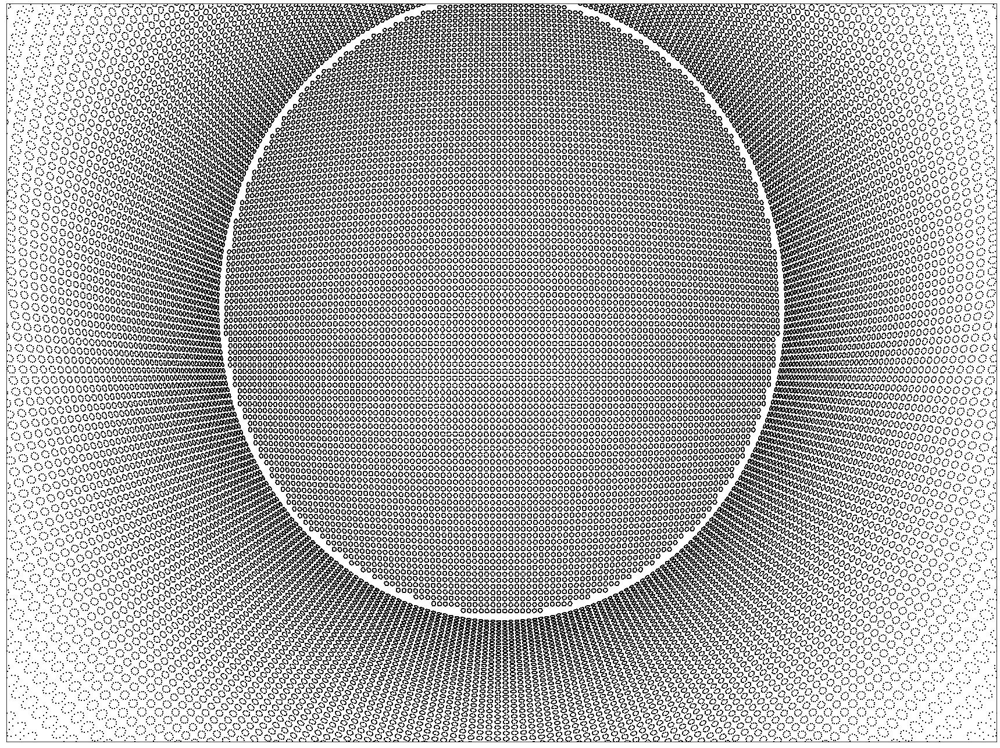

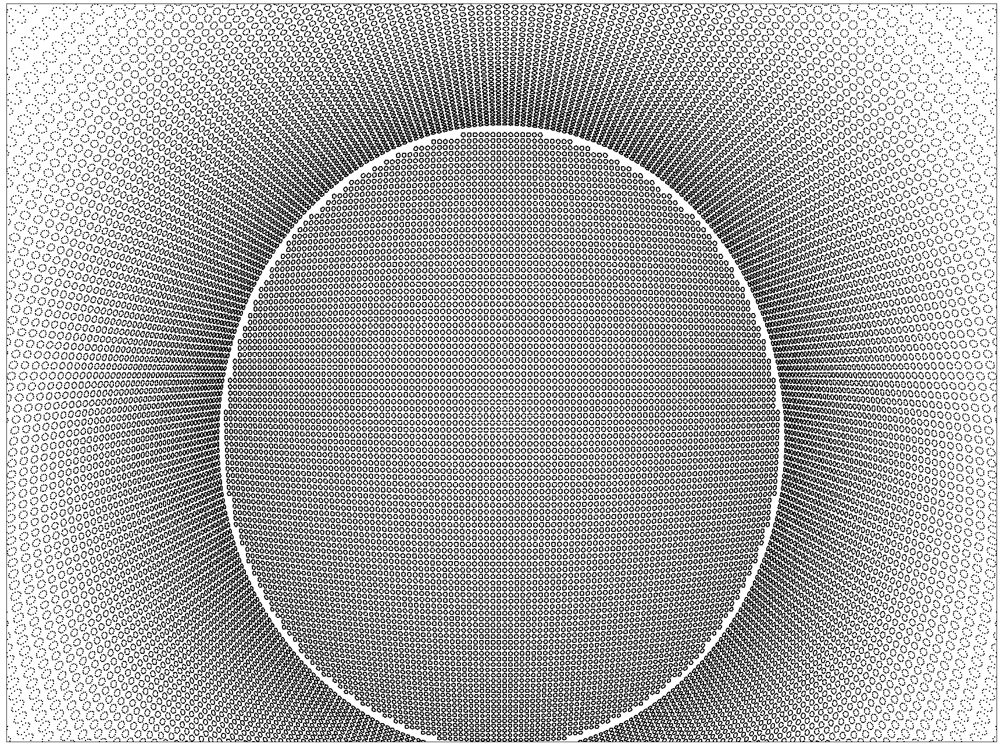

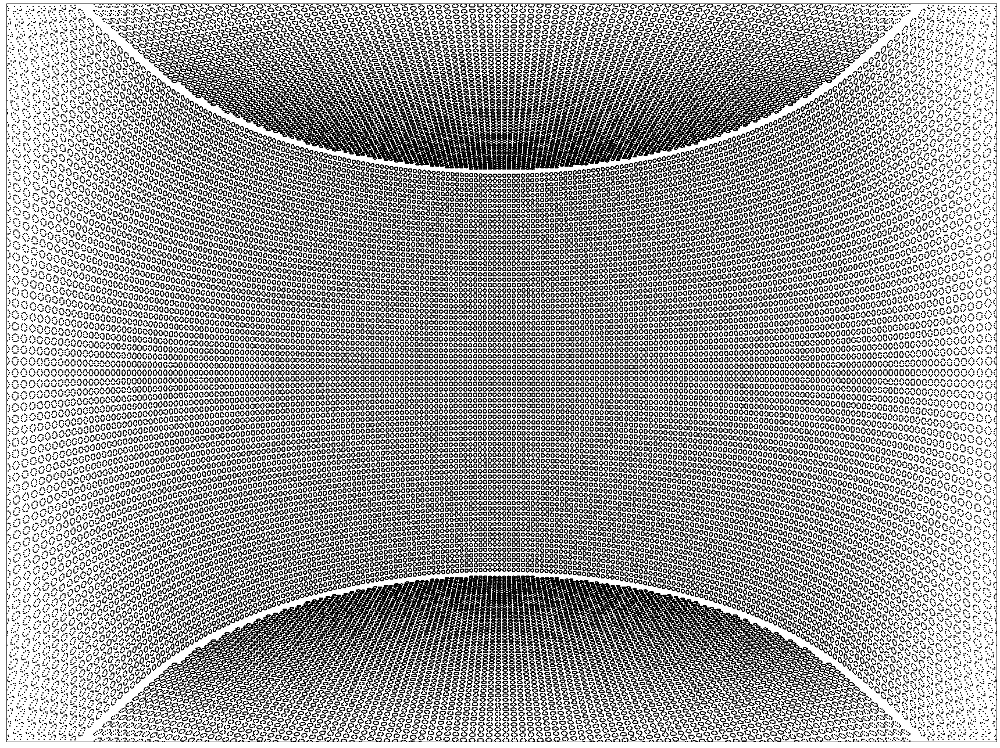

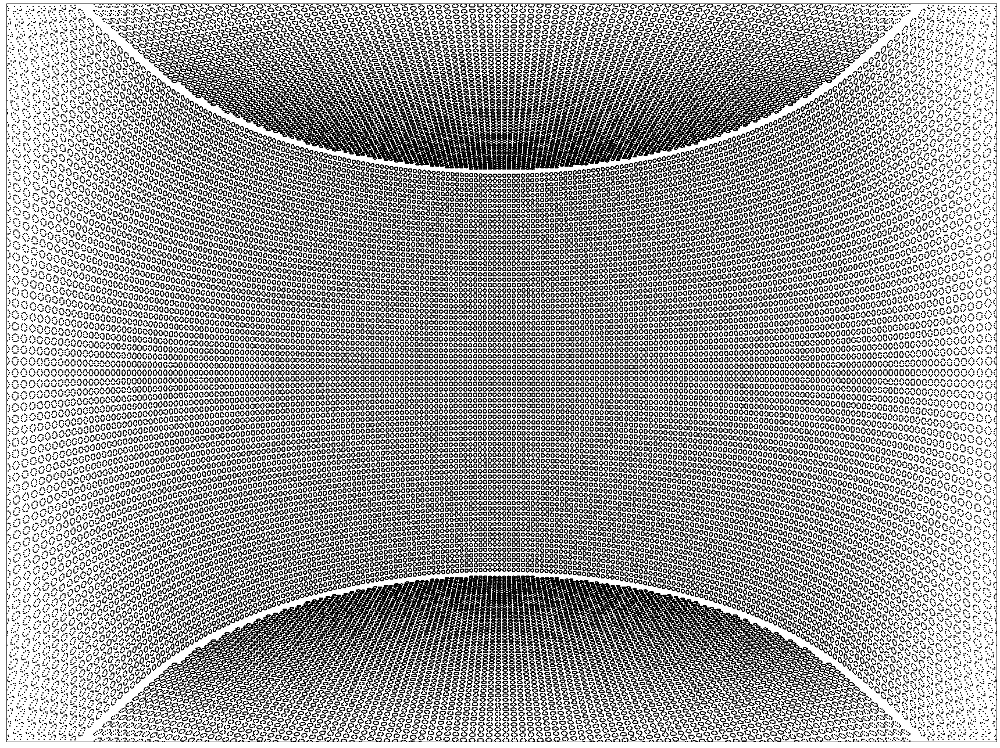

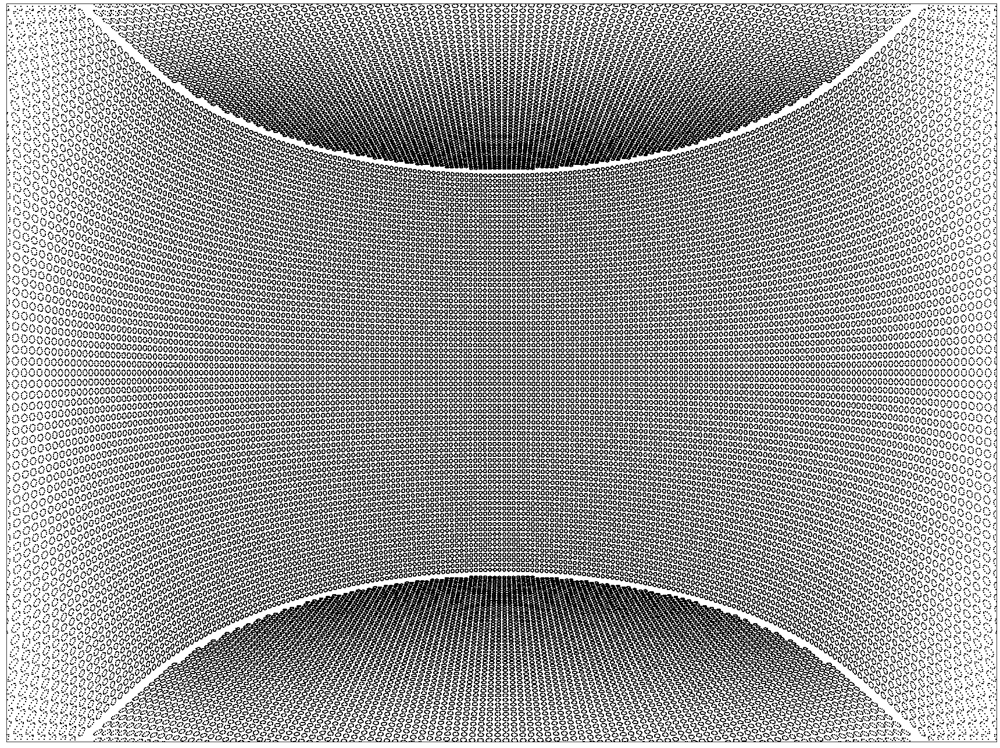

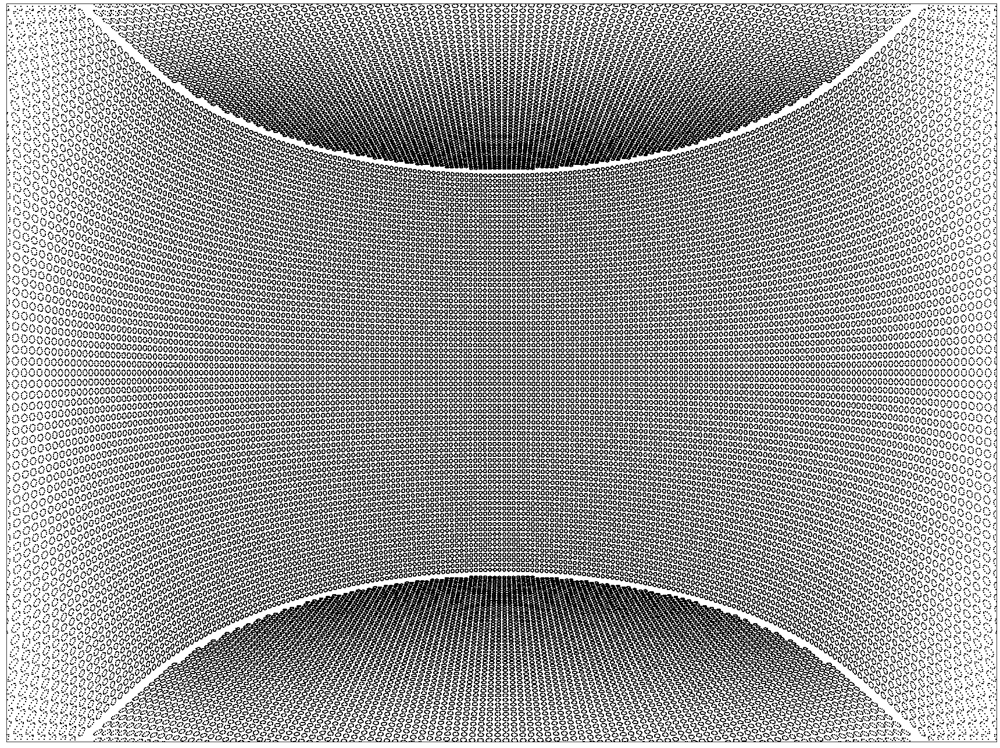

In [202]:
simulator.show_images(image_feature_locations, area=image_area, s=1, marker=',', figsize=(24,18))

In [203]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_8c_A6000_'+str(k)+'.png', v)

# Simulation with Sony a7R-IV

In [40]:
ratio = np.array([9504/6000,6336/4000])
focal_length = np.array([2925.84685880484, 2930.0351899542])*ratio
principle_point = np.array([3000, 2000])*ratio
radial_distortion = np.array([-0.251288719187471, 0.0622370807856553])#[-0.28009, 0.11246, -0.02736])
tangential_distortion = np.array([0, 0])
camera_matrix = fit.build_camera_matrix(focal_length, principle_point)
distortion = fit.build_distortion_array(radial_distortion, tangential_distortion)
image_size = np.array([9504, 6336])
image_area = [[0,image_size[0]],[0,image_size[1]]]

## 6 camera configuration A

In [204]:
camera_radial_position = 3549.1*0.75
camera_halfz_position = 2748.9
camera_positions = np.array([
    [    -camera_radial_position,  0                                  , -camera_halfz_position],
    [ 0.5*camera_radial_position, -camera_radial_position*np.sqrt(3)/2, -camera_halfz_position],
    [ 0.5*camera_radial_position,  camera_radial_position*np.sqrt(3)/2, -camera_halfz_position],
    [     camera_radial_position,  0                                  ,  camera_halfz_position],
    [-0.5*camera_radial_position, -camera_radial_position*np.sqrt(3)/2,  camera_halfz_position],
    [-0.5*camera_radial_position,  camera_radial_position*np.sqrt(3)/2,  camera_halfz_position]])
camera_tilt = 0.92
camera_zenith = np.sqrt(1-camera_tilt**2)
camera_directions = [[   1*camera_zenith,             0*camera_zenith,  camera_tilt],
                     [-0.5*camera_zenith,  np.sqrt(3)/2*camera_zenith,  camera_tilt],
                     [-0.5*camera_zenith, -np.sqrt(3)/2*camera_zenith,  camera_tilt],
                     [  -1*camera_zenith,             0*camera_zenith, -camera_tilt],
                     [ 0.5*camera_zenith,  np.sqrt(3)/2*camera_zenith, -camera_tilt],
                     [ 0.5*camera_zenith, -np.sqrt(3)/2*camera_zenith, -camera_tilt]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, 0.0, 0.0, 0.0, 0.0, 0.0])#[np.pi/2, np.pi/2, np.pi/2, np.pi/2])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [205]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({3: 369720, 4: 48756, 5: 42900})


In [206]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_6a_a7R_'+str(k)+'.png', v)

## 6 camera configuration B

In [207]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [ 0                     ,  0                     , -camera_halfz_position],
    [ 0                     ,  0                     ,  camera_halfz_position],
    [ camera_radial_position,  0                     ,  0                    ],
    [-camera_radial_position,  0                     ,  0                    ],
    [ 0                     ,  camera_radial_position,  0                    ],
    [ 0                     , -camera_radial_position,  0                    ]])
camera_directions = [[ 0,  0,  1],
                     [ 0,  0, -1],
                     [-1,  0,  0],
                     [ 1,  0,  0],
                     [ 0, -1,  0],
                     [ 0,  1,  0]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, np.pi/2, 0.0, 0.0, 0.0, 0.0])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [208]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({3: 333164, 4: 113200, 2: 14964, 5: 48})


In [209]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_6b_a7R_'+str(k)+'.png', v)

## 8 camera configuration A

In [210]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [-camera_radial_position,  0                     , -camera_halfz_position],
    [camera_radial_position ,  0                     , -camera_halfz_position],
    [0                      , -camera_radial_position, -camera_halfz_position],
    [0                      ,  camera_radial_position, -camera_halfz_position],
    [-camera_radial_position,  0                     ,  camera_halfz_position],
    [camera_radial_position ,  0                     ,  camera_halfz_position],
    [0                      , -camera_radial_position,  camera_halfz_position],
    [0                      ,  camera_radial_position,  camera_halfz_position]])
camera_directions = [[ 1,  0,  1.],
                     [-1,  0,  1.],
                     [ 0,  1,  1.],
                     [ 0, -1,  1.],
                     [ 1,  0, -1.],
                     [-1,  0, -1.],
                     [ 0,  1, -1.],
                     [ 0, -1, -1.]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0])#[np.pi/2, np.pi/2, np.pi/2, np.pi/2])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [211]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({4: 194600, 6: 102096, 8: 63488, 3: 40592, 7: 34464, 5: 26136})


In [212]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_8a_a7R_'+str(k)+'.png', v)

## 8 camera configuration B

In [220]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [ 0                                  ,      0                     ,     -camera_halfz_position],
    [ 0                                  ,      0                     ,      camera_halfz_position],
    [ 0                                  ,     -camera_radial_position, -0.3*camera_halfz_position],
    [ camera_radial_position*np.sqrt(3)/2,  0.5*camera_radial_position, -0.3*camera_halfz_position],
    [-camera_radial_position*np.sqrt(3)/2,  0.5*camera_radial_position, -0.3*camera_halfz_position],
    [ 0                                  ,      camera_radial_position,  0.3*camera_halfz_position],
    [ camera_radial_position*np.sqrt(3)/2, -0.5*camera_radial_position,  0.3*camera_halfz_position],
    [-camera_radial_position*np.sqrt(3)/2, -0.5*camera_radial_position,  0.3*camera_halfz_position]])
camera_directions = [[ 0           ,  0  ,    1],
                     [ 0           ,  0  ,   -1],
                     [ 0           ,  1  ,  0.3],
                     [-np.sqrt(3)/2, -0.5,  0.3],
                     [ np.sqrt(3)/2, -0.5,  0.3],
                     [ 0           , -1  , -0.3],
                     [-np.sqrt(3)/2,  0.5, -0.3],
                     [ np.sqrt(3)/2,  0.5, -0.3]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, np.pi/2, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0])#[np.pi/2, np.pi/2, np.pi/2, np.pi/2])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [221]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({4: 260154, 5: 175152, 3: 20996, 6: 5074})


In [222]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_8b_a7R_'+str(k)+'.png', v)

## 8 camera configuration C

In [223]:
camera_radial_position = 3549.1
camera_halfz_position = 2748.9
camera_positions = np.array([
    [ 0                           ,  camera_radial_position*0.255, -camera_halfz_position],
    [ 0                           , -camera_radial_position*0.255, -camera_halfz_position],
    [ camera_radial_position*0.255,  0                           ,  camera_halfz_position],
    [-camera_radial_position*0.255,  0                           ,  camera_halfz_position],
    [ camera_radial_position      ,  0                           ,  0                    ],
    [-camera_radial_position      ,  0                           ,  0                    ],
    [ 0                           ,  camera_radial_position      ,  0                    ],
    [ 0                           , -camera_radial_position      ,  0                    ]])
camera_directions = [[ 0,  0,  1],
                     [ 0,  0,  1],
                     [ 0,  0, -1],
                     [ 0,  0, -1],
                     [-1,  0,  0],
                     [ 1,  0,  0],
                     [ 0, -1,  0],
                     [ 0,  1,  0]]
camera_directions = camera_directions / linalg.norm(camera_directions, axis=1, keepdims=True)
camera_rolls = np.array([0.0, 0.0, np.pi/2, np.pi/2, 0.0, 0.0, 0.0, 0.0])
camera_rotations, camera_translations = fit.camera_poses(camera_positions, camera_directions, camera_rolls, vertical_axis=2)
camera_count = camera_positions.shape[0]
simulator = fit.PhotogrammetrySimulator(feature_positions, focal_length, principle_point, camera_rotations, camera_translations, radial_distortion, tangential_distortion)

In [224]:
image_feature_locations = simulator.get_image_feature_locations(area_restrict = image_area, min_feature_count = 2)
feature_counts = Counter([f for i in image_feature_locations.values() for f in i.keys()])
feature_counts_counts = Counter(feature_counts.values())
print("Total number of features: ", len(feature_positions))
print("Number of features in more than one image: ", sum(feature_counts_counts.values()))
print("Feature in image counts:", feature_counts_counts)

Total number of features:  461376
Number of features in more than one image:  461376
Feature in image counts: Counter({4: 308744, 5: 95780, 3: 56804, 6: 48})


In [225]:
images = simulator.make_images(image_feature_locations, area=image_area)
for k,v in images.items():
    cv2.imwrite('HK_8c_a7R_'+str(k)+'.png', v)